# Analyzes for Aurélien Fortoul

#### Here we will analyze results from different groups of mice doing the 4-Towers tasks. Precisely, we will compare mice with Eml1 or RhoA gene mutated to their control (WT from the same lineage). Additionally, we also have data from Black6 mice with(out) their whiskers trimmed.
#### All mice went through the same protocol: 6 days in one direction (CCW), with limited amount of rewards (4-12) but free to explore each tower. After that, the direction switched to CW for 3 days. Then, a hard protocol was applied for X days: one random rewarding direction drawn at each tower visit, only one tower rewarding that changes randomly when the animal leaves a tower. 

##### First, import all libraries necessary to process this code for all groups and define the general path to your datas. This path must lead to a folder containing all mice for those groups.

In [1]:
# Libraries imports

import os
import pickle
import gc
import itertools

import matplotlib.pyplot as plt
import matplotlib.path as mpath
import matplotlib.cm as cm
import pandas as pd
import numpy as np
import seaborn as sns
import similaritymeasures as sm

from matplotlib import cm
from matplotlib.colors import Normalize
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.gridspec import GridSpec, GridSpecFromSubplotSpec
from matplotlib.backends.backend_pdf import PdfPages
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import wilcoxon
from scipy.stats import pearsonr
from processing_session_trajectory import *


In [41]:
# Path leading to your datas

path_to_data_folder = '/home/david/MyLocalData/Aurelien/'
pattern_of_MOU_Folders = os.path.join(path_to_data_folder, "MOU*") # All mice folders and files should start with "MOU" to be recognized here

# List of all mice and their sessions

mice_list: list[str] = ["MOUEml1_5","MOUEml1_8","MOUEml1_11", "MOUEml1_12", "MOUEml1_13", "MOUEml1_15", "MOUEml1_18","MOUEml1_20",
                        "MOUEml1_6", "MOUEml1_7","MOUEml1_9","MOUEml1_10","MOUEml1_14", "MOUEml1_16","MOUEml1_17","MOUEml1_19",
                        "MOURhoA_2","MOURhoA_5","MOURhoA_6","MOURhoA_8","MOURhoA_9","MOURhoA_12","MOURhoA_14",
                        "MOURhoA_1","MOURhoA_3","MOURhoA_4","MOURhoA_7","MOURhoA_10","MOURhoA_11","MOURhoA_13"
                        ]

session_list = {}
for mouse in mice_list:
    mouse_folder = os.path.join(path_to_data_folder,mouse)
    session_list[mouse] = sorted([name for name in os.listdir(mouse_folder)
                           if os.path.isdir(os.path.join(mouse_folder, name))
                           and name.startswith('MOU')])
    nb_sessions = len(session_list[mouse])
    # print(f'Hello, I\'m {mouse}! I have foraged for {nb_sessions} sessions')

##### Data extraction: here extract datas from pickle files and create dictionnaries for all mice

In [42]:
# Define dictionaries to store results per session and per mouse
positions_cm_dict = {}
X_positions_dict = {}
Y_positions_dict = {}
total_distances = {}
average_speeds = {}
distances_dict = {}
speeds_dict = {}
angular_speeds_dict = {}
all_epochs_dict = {}
traject_time_dict = {}
run_around_tower_results_dict = {}
runs_around_tower_dict = {}
trapezes_coordinates_dict = {}
towers_coordinates_dict = {}
runs_between_towers_dict = {}
exploratory_runs_dict = {}
time_border_dict = {}
time_interior_dict = {}
time_trapeze_dict = {}
distance_border_dict = {}
distance_interior_dict = {}
distance_trapeze_dict = {}
ratio_time_trapeze_over_border = {}
ratio_distance_trapeze_over_border = {}
time_trapeze_minus_border = {}
distance_trapeze_minus_border = {}


# Loop to process each mouse
for mouse in mice_list:
    
    # Initialize subdictionaries for each mouse
    positions_cm_dict[mouse] = {}
    X_positions_dict[mouse] = {}
    Y_positions_dict[mouse] = {}
    total_distances[mouse] = {}
    average_speeds[mouse] = {}
    distances_dict[mouse] = {}
    speeds_dict[mouse] = {}
    angular_speeds_dict[mouse] = {}
    all_epochs_dict[mouse] = {}
    traject_time_dict[mouse] = {}
    run_around_tower_results_dict[mouse] = {}
    runs_around_tower_dict[mouse] = {}
    trapezes_coordinates_dict[mouse] = {}
    towers_coordinates_dict[mouse] = {}
    runs_between_towers_dict[mouse] = {}
    exploratory_runs_dict[mouse] = {}
    time_border_dict[mouse] = {}
    time_interior_dict[mouse] = {}
    time_trapeze_dict[mouse] = {}
    distance_border_dict[mouse] = {}
    distance_interior_dict[mouse] = {}
    distance_trapeze_dict[mouse] = {}
    ratio_time_trapeze_over_border[mouse] = {}
    ratio_distance_trapeze_over_border[mouse] = {}
    time_trapeze_minus_border[mouse] = {}
    distance_trapeze_minus_border[mouse] = {}

    for session_index, session_name in enumerate(session_list[mouse]):
        
        output_pickle_filepath = os.path.join(path_to_data_folder, mouse, session_name, f"{session_name}_basic_processing_output.pickle")

        if not os.path.exists(output_pickle_filepath) or os.path.getsize(output_pickle_filepath) == 0:
            print(f"Erreur : le fichier {output_pickle_filepath} n'existe pas ou est vide.")
            positions_cm_dict[mouse][session_index] = np.nan
            X_positions_dict[mouse][session_index] = np.nan
            Y_positions_dict[mouse][session_index] = np.nan
            total_distances[mouse][session_index] = np.nan
            average_speeds[mouse][session_index] = np.nan
            distances_dict[mouse][session_index] = np.nan
            speeds_dict[mouse][session_index] = np.nan
            angular_speeds_dict[mouse][session_index] = np.nan
            all_epochs_dict[mouse][session_index] = np.nan
            traject_time_dict[mouse][session_index] = np.nan
            run_around_tower_results_dict[mouse][session_index] = np.nan
            runs_around_tower_dict[mouse][session_index] = np.nan
            trapezes_coordinates_dict[mouse][session_index] = np.nan
            towers_coordinates_dict[mouse][session_index] = np.nan
            runs_between_towers_dict[mouse][session_index] = np.nan
            exploratory_runs_dict[mouse][session_index] = np.nan
            time_border_dict[mouse][session_index] = np.nan
            time_interior_dict[mouse][session_index] = np.nan
            time_trapeze_dict[mouse][session_index] = np.nan
            distance_border_dict[mouse][session_index] = np.nan
            distance_interior_dict[mouse][session_index] = np.nan
            distance_trapeze_dict[mouse][session_index] = np.nan
            ratio_time_trapeze_over_border[mouse][session_index] = np.nan
            ratio_distance_trapeze_over_border[mouse][session_index] = np.nan
            time_trapeze_minus_border[mouse][session_index] = np.nan
            distance_trapeze_minus_border[mouse][session_index] = np.nan

            continue
        
        else:

            # Loading data from the pickle
            try:
                with open(output_pickle_filepath, 'rb') as f:
                    data = pickle.load(f)
            except EOFError:
                print(f"Erreur de lecture : le fichier {output_pickle_filepath} semble être corrompu.")
                continue

            # Data extraction
            positions_cm = data['positions']
            X_positions_cm = data['positions'][0]
            Y_positions_cm = data['positions'][1]
            average_speed = data['average_speed']
            distances = data['distances']
            speeds = data['speeds']
            angular_speeds = data['angular_speeds']
            all_epochs = data['all_epochs']
            traject_time = data['timeofframes']
            run_around_tower_results = data['run_around_tower_sessionresult']
            runs_around_tower = all_epochs['run_around_tower']
            runs_between_towers = all_epochs['run_between_towers']
            exploratory_runs = all_epochs['exploratory_run']
            trapezes_coordinates = data['all_trapezes_coordinates_cm']
            towers_coordinates = data['towers_coordinates_cm']
            time_border = data['time_in_zones']['border']
            time_interior = data['time_in_zones']['interior']
            time_trapeze = data['time_in_zones']['trapeze']
            distance_border = data['distance_in_zones']['border']
            distance_interior = data['distance_in_zones']['interior']
            distance_trapeze = data['distance_in_zones']['trapeze']

            # Calculation of total distance in meters
            total_distance = np.sum(distances) / 100

            # Storing in full dictionaries using session index
            positions_cm_dict[mouse][session_index] = positions_cm
            X_positions_dict[mouse][session_index] = X_positions_cm
            Y_positions_dict[mouse][session_index] = Y_positions_cm
            total_distances[mouse][session_index] = total_distance
            average_speeds[mouse][session_index] = average_speed
            distances_dict[mouse][session_index] = distances
            speeds_dict[mouse][session_index] = speeds
            angular_speeds_dict[mouse][session_index] = angular_speeds
            all_epochs_dict[mouse][session_index] = all_epochs
            traject_time_dict[mouse][session_index] = traject_time
            run_around_tower_results_dict[mouse][session_index] = run_around_tower_results
            runs_around_tower_dict[mouse][session_index] = runs_around_tower
            trapezes_coordinates_dict[mouse][session_index] = trapezes_coordinates
            towers_coordinates_dict[mouse][session_index] = towers_coordinates
            runs_between_towers_dict[mouse][session_index] = runs_between_towers
            exploratory_runs_dict[mouse][session_index] = exploratory_runs
            time_border_dict[mouse][session_index] = time_border
            time_interior_dict[mouse][session_index] = time_interior
            time_trapeze_dict[mouse][session_index] = time_trapeze
            distance_border_dict[mouse][session_index] = distance_border
            distance_interior_dict[mouse][session_index] = distance_interior
            distance_trapeze_dict[mouse][session_index] = distance_trapeze

            if time_border == 0:
                ratio_time_trapeze_over_border[mouse][session_index] = 0
            else:
                ratio_time_trapeze_over_border[mouse][session_index] = time_trapeze/time_border

            if distance_border == 0:
                ratio_distance_trapeze_over_border[mouse][session_index] = 0
            else:
                ratio_distance_trapeze_over_border[mouse][session_index] = distance_trapeze/distance_border

            time_trapeze_minus_border[mouse][session_index] = time_trapeze - time_border
            distance_trapeze_minus_border[mouse][session_index] = distance_trapeze - distance_border


Erreur : le fichier /home/david/MyLocalData/Aurelien/MOUEml1_6/MOUEml1_6_20230423-1108/MOUEml1_6_20230423-1108_basic_processing_output.pickle n'existe pas ou est vide.
Erreur : le fichier /home/david/MyLocalData/Aurelien/MOURhoA_12/MOURhoA_12_20240723-1120/MOURhoA_12_20240723-1120_basic_processing_output.pickle n'existe pas ou est vide.


In [43]:
# Dictionnaries of CW/CCW/rewarded/unrewarded/total runs around towers

total_QT_dict = {}
total_QT_rewarded_dict = {}
total_QT_unrewarded_dict = {}
total_CW_dict = {}
total_CCW_dict = {}
ratio_CW_CCW_dict = {}
percentage_rewarded_dict = {}

for mouse in mice_list:
    
    total_QT_dict[mouse] = {}
    total_QT_rewarded_dict[mouse] = {}
    total_QT_unrewarded_dict[mouse] = {}
    total_CW_dict[mouse] = {}
    total_CCW_dict[mouse] = {}
    ratio_CW_CCW_dict[mouse] = {}
    percentage_rewarded_dict[mouse] = {}

    for session_index, session_name in enumerate(session_list[mouse]):

        session_data = run_around_tower_results_dict[mouse].get(session_index, None)

        # 🛡️ If the session has not been filled (missing or corrupted pickle), we set np.nan
        if session_data is None or pd.isna(session_data):
            total_QT_dict[mouse][session_index] = np.nan
            total_QT_rewarded_dict[mouse][session_index] = np.nan
            total_QT_unrewarded_dict[mouse][session_index] = np.nan
            total_CW_dict[mouse][session_index] = np.nan
            total_CCW_dict[mouse][session_index] = np.nan
            ratio_CW_CCW_dict[mouse][session_index] = np.nan
            percentage_rewarded_dict[mouse][session_index] = np.nan
            continue

        # ✅ Normal processing if the data is present
        else:
            total_CW_rewarded = session_data['All']['rewarded_CW']
            total_CCW_rewarded = session_data['All']['rewarded_CCW']
            total_CW = session_data['All']['total_CW']
            total_CCW = session_data['All']['total_CCW']
            
            total_QT = total_CW + total_CCW
            total_QT_rewarded = total_CW_rewarded + total_CCW_rewarded
            total_QT_unrewarded = total_QT - total_QT_rewarded
            if total_QT == 0:
                ratio_CW_CCW = 0
                percentage_rewarded = 0
            else:
                ratio_CW_CCW = (total_CW - total_CCW) / total_QT
                percentage_rewarded = round((total_QT_rewarded / total_QT) * 100, 2)

            total_QT_dict[mouse][session_index] = total_QT
            total_QT_rewarded_dict[mouse][session_index] = total_QT_rewarded
            total_QT_unrewarded_dict[mouse][session_index] = total_QT_unrewarded
            total_CW_dict[mouse][session_index] = total_CW
            total_CCW_dict[mouse][session_index] = total_CCW
            ratio_CW_CCW_dict[mouse][session_index] = ratio_CW_CCW
            percentage_rewarded_dict[mouse][session_index] = percentage_rewarded if session_index != 0 else 0


In [44]:
# Retrieve distance, time, mean speed, max speed
# Initialize counters and lists for run analysis

total_time_QT_dict = {}
total_distance_QT_dict = {}
meanspeed_QT_dict = {}
maxspeed_QT_dict = {}

for mouse in mice_list:
    total_time_QT_dict[mouse] = {}
    total_distance_QT_dict[mouse] = {}
    meanspeed_QT_dict[mouse] = {}
    maxspeed_QT_dict[mouse] = {}

    for session_index, session_name in enumerate(session_list[mouse]):
            
        session_data = run_around_tower_results_dict[mouse].get(session_index, None)

        # 🛡️ If the session has not been filled (missing or corrupted pickle), we set np.nan
        if session_data is None or pd.isna(session_data):
            meanspeed_QT_dict[mouse][session_index] = np.nan
            maxspeed_QT_dict[mouse][session_index] = np.nan
            total_time_QT_dict[mouse][session_index] = np.nan
            total_distance_QT_dict[mouse][session_index] = np.nan
            continue

        else:
            total_time_QT = 0
            total_distance_QT = 0
            speed_QT = []

            for run in runs_around_tower_dict[mouse][session_index]:
                start_index, end_index = run[0][0], run[0][1]
                run_duration = traject_time_dict[mouse][session_index][end_index] - traject_time_dict[mouse][session_index][start_index]
                distance_ran = np.sum(distances_dict[mouse][session_index][start_index:end_index])

                # Accumulate metrics
                speed_QT.append(distance_ran / run_duration)
                total_time_QT += run_duration
                total_distance_QT += distance_ran

            # Store results for this session in the dictionaries
            meanspeed_QT_dict[mouse][session_index] = np.mean(speed_QT)
            maxspeed_QT_dict[mouse][session_index] = np.max(speed_QT)
            total_time_QT_dict[mouse][session_index] = round(total_time_QT, 2)
            total_distance_QT_dict[mouse][session_index] = round(total_distance_QT, 2)

In [45]:
# Dictionnaries of CW/CCW/rewarded/unrewarded/total runs around towers

total_QT_dict = {}
total_QT_rewarded_dict = {}
total_QT_unrewarded_dict = {}
total_CW_dict = {}
total_CCW_dict = {}
ratio_CW_CCW_dict = {}
percentage_rewarded_dict = {}

for mouse in mice_list:
    
    total_QT_dict[mouse] = {}
    total_QT_rewarded_dict[mouse] = {}
    total_QT_unrewarded_dict[mouse] = {}
    total_CW_dict[mouse] = {}
    total_CCW_dict[mouse] = {}
    ratio_CW_CCW_dict[mouse] = {}
    percentage_rewarded_dict[mouse] = {}

    for session_index, session_name in enumerate(session_list[mouse]):

        session_data = run_around_tower_results_dict[mouse].get(session_index, None)

        # 🛡️ If the session has not been filled (missing or corrupted pickle), we set np.nan
        if session_data is None or pd.isna(session_data):
            total_QT_dict[mouse][session_index] = np.nan
            total_QT_rewarded_dict[mouse][session_index] = np.nan
            total_QT_unrewarded_dict[mouse][session_index] = np.nan
            total_CW_dict[mouse][session_index] = np.nan
            total_CCW_dict[mouse][session_index] = np.nan
            ratio_CW_CCW_dict[mouse][session_index] = np.nan
            percentage_rewarded_dict[mouse][session_index] = np.nan
            continue
        else:
            total_CW_rewarded = run_around_tower_results_dict[mouse][session_index]['All']['rewarded_CW']
            total_CCW_rewarded = run_around_tower_results_dict[mouse][session_index]['All']['rewarded_CCW']
            total_CW = run_around_tower_results_dict[mouse][session_index]['All']['total_CW']
            total_CCW = run_around_tower_results_dict[mouse][session_index]['All']['total_CCW']
            
            total_QT = total_CW + total_CCW
            total_QT_rewarded = total_CW_rewarded + total_CCW_rewarded
            total_QT_unrewarded = total_QT - total_QT_rewarded
            ratio_CW_CCW = (total_CW - total_CCW) / total_QT
            percentage_rewarded = round((total_QT_rewarded / total_QT) * 100, 2)

            total_QT_dict[mouse][session_index] = total_QT
            total_QT_rewarded_dict[mouse][session_index] = total_QT_rewarded
            total_QT_unrewarded_dict[mouse][session_index] = total_QT_unrewarded
            total_CW_dict[mouse][session_index] = total_CW
            total_CCW_dict[mouse][session_index] = total_CCW
            ratio_CW_CCW_dict[mouse][session_index] = ratio_CW_CCW
            if session_index == 0:
                percentage_rewarded_dict[mouse][session_index] = 0
            else:
                percentage_rewarded_dict[mouse][session_index] = percentage_rewarded


In [46]:
# Dictionary to store rewarded directions per session and per mouse
rewarded_direction_per_session = {}

# Browse each mouse in the mouse list
for mouse in mice_list:
    rewarded_direction_per_session[mouse] = {}  # Initialize the subdictionary for each mouse
    
    # Browse each session of this mouse
    for session_index, session_name in enumerate(session_list[mouse]):
        # Build the path to the CSV file
        csv_file_path = os.path.join(path_to_data_folder, mouse, session_name, f"{session_name}_sessionparam.csv")
        
        # Read the CSV file to get the potentialRewardedDirections column
        try:
            session_data = pd.read_csv(csv_file_path)
            rewarded_directions = session_data["potentialRewardedDirections"].iloc[0]
            
            # Decoding the rewarded direction
            if rewarded_directions == "[90]":
                direction = "CCW"
            elif rewarded_directions == "[270]":
                direction = "CW"
            else:
                direction = "both"
            
            # Add this information to the dictionary
            rewarded_direction_per_session[mouse][session_index] = direction

        except FileNotFoundError:
            print(f"Fichier {csv_file_path} non trouvé.")
            rewarded_direction_per_session[mouse][session_index] = None
        except Exception as e:
            print(f"Erreur lors de la lecture de {csv_file_path}: {e}")

Fichier /home/david/MyLocalData/Aurelien/MOUEml1_6/MOUEml1_6_20230423-1108/MOUEml1_6_20230423-1108_sessionparam.csv non trouvé.
Fichier /home/david/MyLocalData/Aurelien/MOURhoA_12/MOURhoA_12_20240723-1120/MOURhoA_12_20240723-1120_sessionparam.csv non trouvé.


In [47]:
# Dictionary to store percentage of success (turns in rewarded direction)

success_percentage_dict = {}

for mouse in mice_list:
    success_percentage_dict[mouse] = {}

    # Browse each mouse session
    for session_index, session_name in enumerate(session_list[mouse]):

        session_data = run_around_tower_results_dict[mouse].get(session_index, None)

        # 🛡️ If the session has not been filled (missing or corrupted pickle), we set np.nan
        if session_data is None or pd.isna(session_data):
            success_percentage_dict[mouse][session_index] = np.nan
            continue
        else: 
            # Recover the rewarded management of the session
            rewarded_direction = rewarded_direction_per_session[mouse].get(session_index, "both")
            
            # Retrieve results for CW and CCW
            total_CW = run_around_tower_results_dict[mouse][session_index]['All']['total_CW']
            total_CCW = run_around_tower_results_dict[mouse][session_index]['All']['total_CCW']
            
            # Calculate the percentages for CW and CCW
            if total_CW + total_CCW > 0:  # Avoid division by zero
                percentage_CW = round((total_CW / (total_CW + total_CCW)) * 100, 2)
                percentage_CCW = round((total_CCW / (total_CW + total_CCW)) * 100, 2)
            else:
                percentage_CW = percentage_CCW = 0  # If no run, success percentage is 0
                
            # Select the percentage based on the direction rewarded
            if rewarded_direction == "both":
                success_percentage = percentage_rewarded_dict[mouse][session_index]
            elif rewarded_direction == "CW":
                success_percentage = percentage_CW
            elif rewarded_direction == "CCW":
                success_percentage = percentage_CCW
            else:
                print(f"No rewarded direction defined for session {session_index}")
                success_percentage = 0  # Default case if an unexpected value is present

            # Add to dictionary
            success_percentage_dict[mouse][session_index] = success_percentage

In [48]:
# Dictionaries for storing the results of angular velocities of runs between towers
angular_speeds_BT = {}
median_angular_speed_BT = {}

# Loop for each animal
for mouse in mice_list:
    # Initializing dictionaries for the animal
    angular_speeds_BT[mouse] = {}
    median_angular_speed_BT[mouse] = {}

    # Loop for each session
    for session_index, session_name in enumerate(session_list[mouse]):

        session_data = runs_between_towers_dict[mouse].get(session_index, None)

        # 🛡️ If the session has not been filled (missing or corrupted pickle), we set np.nan
        if session_data is None or (isinstance(session_data, float) and np.isnan(session_data)):
            angular_speeds_BT[mouse][session_index] = np.nan
            median_angular_speed_BT[mouse][session_index] = np.nan
            continue
        else: 
            # Initialize a list to store all angular velocities for runs between towers in this session
            session_angular_speeds = []
            
            # Extraction of runs between towers
            runs_between_towers = runs_between_towers_dict[mouse][session_index]
            
            # Loop for each run between towers
            for run in runs_between_towers:

                # Extracting the start and end indices of the run
                start_idx, end_idx = run[0]  # Indexes to extract data

                # Extraction of trajectory coordinates and time for the run
                X_run = X_positions_dict[mouse][session_index][start_idx:end_idx]
                Y_run = Y_positions_dict[mouse][session_index][start_idx:end_idx]
                time_run = traject_time_dict[mouse][session_index][start_idx:end_idx]

                # Verify that the extracted data is valid
                if len(X_run) > 1 and len(Y_run) > 1 and len(time_run) > 1:
                    # Calculation of distances, speeds and angular velocities
                    distances, speeds, angular_speeds = compute_distance_speed_angular_speed(
                        [X_run, Y_run], time_run
                    )
                    # Add angular velocities of runs to the session list
                    session_angular_speeds.extend(angular_speeds)
                else:
                    print(f"Run invalide pour la souris {mouse}, session {session_name}, indices ({start_idx}, {end_idx}).")

            # Storing session angular velocities in the dictionary
            angular_speeds_BT[mouse][session_index] = session_angular_speeds
            
            # Calculating the median angular velocities for this session
            if session_angular_speeds:  # Check if there are angular velocities to avoid errors
                median_angular_speed_BT[mouse][session_index] = np.nanmedian(session_angular_speeds)
            else:
                median_angular_speed_BT[mouse][session_index] = np.nan  # If no angular velocity, median not calculable


In [49]:
# Retrieve distance, time, mean speed, max speed of BT
# Initialize counters and lists for run analysis

total_time_BT_dict = {}
total_distance_BT_dict = {}
meanspeed_BT_dict = {}
maxspeed_BT_dict = {}

for mouse in mice_list:
    total_time_BT_dict[mouse] = {}
    total_distance_BT_dict[mouse] = {}
    meanspeed_BT_dict[mouse] = {}
    maxspeed_BT_dict[mouse] = {}

    for session_index, session_name in enumerate(session_list[mouse]):

        session_data = runs_between_towers_dict[mouse].get(session_index, None)

        # 🛡️ If the session has not been filled (missing or corrupted pickle), we set np.nan
        if session_data is None or (isinstance(session_data, float) and np.isnan(session_data)):
            total_time_BT_dict[mouse][session_index] = np.nan
            total_distance_BT_dict[mouse][session_index] = np.nan
            meanspeed_BT_dict[mouse][session_index] = np.nan
            maxspeed_BT_dict[mouse][session_index] = np.nan
            continue
        else: 
            total_time_BT = 0
            total_distance_BT = 0
            meanspeed_BT = []
            maxspeed_BT = []

            for run in runs_between_towers_dict[mouse][session_index]:
                start_index, end_index = run[0][0], run[0][1]
                run_X_position = X_positions_dict[mouse][session_index][start_index:end_index + 1]
                run_Y_position = Y_positions_dict[mouse][session_index][start_index:end_index + 1]
                run_duration = traject_time_dict[mouse][session_index][end_index] - traject_time_dict[mouse][session_index][start_index]
                distance_ran = np.sum(distances_dict[mouse][session_index][start_index:end_index])

                # Accumulate metrics
                total_time_BT += run_duration
                total_distance_BT += distance_ran
                meanspeed_BT.append(distance_ran / run_duration)
                maxspeed_BT.append(np.max(speeds_dict[mouse][session_index][start_index:end_index]))

            # Store results for this session in the dictionaries
            total_time_BT_dict[mouse][session_index] = total_time_BT
            total_distance_BT_dict[mouse][session_index] = total_distance_BT
            meanspeed_BT_dict[mouse][session_index] = np.mean(meanspeed_BT)
            maxspeed_BT_dict[mouse][session_index] = np.max(maxspeed_BT)

In [50]:
# Retrieve distance, time, mean speed, max speed of exploratory runs
# Initialize counters and lists for run analysis

total_time_ER_dict = {}
total_distance_ER_dict = {}
meanspeed_ER_dict = {}
maxspeed_ER_dict = {}

for mouse in mice_list:

    total_time_ER_dict[mouse] = {}
    total_distance_ER_dict[mouse] = {}
    meanspeed_ER_dict[mouse] = {}
    maxspeed_ER_dict[mouse] = {}

    for session_index, session_name in enumerate(session_list[mouse]):

        session_data = exploratory_runs_dict[mouse].get(session_index, None)

        # 🛡️ If the session has not been filled (missing or corrupted pickle), we set np.nan
        if session_data is None or (isinstance(session_data, float) and np.isnan(session_data)):
            total_time_ER_dict[mouse][session_index] = np.nan
            total_distance_ER_dict[mouse][session_index] = np.nan
            meanspeed_ER_dict[mouse][session_index] = np.nan
            maxspeed_ER_dict[mouse][session_index] = np.nan
            continue
        else:
            total_time_ER = 0
            total_distance_ER = 0
            meanspeed_ER = []
            maxspeed_ER = []

            for run in exploratory_runs_dict[mouse][session_index]:
                start_index, end_index = run[0][0], run[0][1]
                run_X_position = X_positions_dict[mouse][session_index][start_index:end_index + 1]
                run_Y_position = Y_positions_dict[mouse][session_index][start_index:end_index + 1]
                run_duration = traject_time_dict[mouse][session_index][end_index] - traject_time_dict[mouse][session_index][start_index]
                distance_ran = np.sum(distances_dict[mouse][session_index][start_index:end_index])

                # Accumulate metrics
                total_time_ER += run_duration
                total_distance_ER += distance_ran
                meanspeed_ER.append(distance_ran / run_duration)
                maxspeed_ER.append(np.max(speeds_dict[mouse][session_index][start_index:end_index]))

            # Store results for this session in the dictionaries
            total_time_ER_dict[mouse][session_index] = total_time_ER
            total_distance_ER_dict[mouse][session_index] = total_distance_ER
            meanspeed_ER_dict[mouse][session_index] = np.mean(meanspeed_ER)
            maxspeed_ER_dict[mouse][session_index] = np.max(maxspeed_ER)


##### Creation of functions that will be used for all groups

In [51]:
# Function to do a permutation test between 2 groups

def permutation_test(group_values, n_permutations=2000):
    """
    Perform a permutation test to compare two groups.

    Parameters
    ----------
    group_values : dict
        Dictionary containing the metric values for each group.
        Format: { "Group Name": np.array([...]), ... }

    n_permutations : int, optional
        Number of permutations for the permutation test. Default is 1000.

    Returns
    -------
    p_values : np.array
        Array of p-values for each session.
    """
    group_names = list(group_values.keys())
    observed_diff = np.nanmedian(group_values[group_names[0]], axis=0) - np.nanmedian(group_values[group_names[1]], axis=0)
    permuted_diffs = []

    for _ in range(n_permutations):
        permuted_group_values = {group: np.random.permutation(values.flatten()).reshape(values.shape) for group, values in group_values.items()}
        permuted_diff = np.nanmedian(permuted_group_values[group_names[0]], axis=0) - np.nanmedian(permuted_group_values[group_names[1]], axis=0)
        permuted_diffs.append(permuted_diff)

    permuted_diffs = np.array(permuted_diffs)
    p_values = np.mean(np.abs(permuted_diffs) >= np.abs(observed_diff), axis=0)

    return p_values


In [52]:
def plot_metric_evolution_between_groups(ax, data_dict, groups, group_colors, title=None, ylabel="Value", xlabel="Session", n_permutations=2000, ylim=None):
    """
    Plots the evolution of a metric across sessions for different groups of mice and performs a permutation test.

    Parameters
    ----------
    ax : matplotlib.axes.Axes
        An existing matplotlib Axes object to plot into.

    data_dict : dict
        Dictionary containing the metric values per mouse and per session.
        Format: { "mouse_name": {session_index: value, ...}, ... }

    groups : dict
        Dictionary defining the experimental groups.
        Format: { "Group Name": ["mouse1", "mouse2", ...], ... }

    group_colors : dict
        Dictionary mapping group names to their corresponding colors.
        Format: { "Group Name": "#hexcolor", ... }

    title : str, optional
        Title of the plot. Default is None (no title).

    ylabel : str, optional
        Label for the Y-axis. Default is "Value".

    xlabel : str, optional
        Label for the X-axis. Default is "Session".

    n_permutations : int, optional
        Number of permutations for the permutation test. Default is 1000.
    """

    markers = itertools.cycle(('o', 's', '^', 'D', 'v', 'p', '*', 'x', '+', '1', '2', '3', '4'))
    max_global_session = 0

    group_names = list(groups.keys())
    group_values = {group: [] for group in group_names}
    max_session = 0

    for group_name, mice in groups.items():
        for mouse in mice:
            if mouse not in data_dict:
                print(f"Mouse missing from data: {mouse}")
                continue

            sessions = sorted(data_dict[mouse].keys())
            max_session = max(max_session, max(sessions) + 1)
            values = [data_dict[mouse].get(s, np.nan) for s in range(max_session)]
            group_values[group_name].append(values)

    max_global_session = max_session

    # Convert group_values to numpy arrays
    group_values = {group: np.array(values) for group, values in group_values.items()}

    # Plot individual curves
    for group_name, values in group_values.items():
        marker_cycle = itertools.cycle(markers)
        for idx, value_series in enumerate(values):
            ax.plot(range(len(value_series)), value_series,
                    color=group_colors[group_name],
                    alpha=0.2,
                    linewidth=1.5,
                    linestyle='-',
                    marker=next(marker_cycle),
                    markersize=5)

        # Plot median curve
        median_values = np.nanmedian(values, axis=0)
        ax.plot(range(len(median_values)), median_values,
                label=f"{group_name} (median)",
                color=group_colors[group_name],
                linewidth=3)

    # Perform permutation test
    p_values = permutation_test(group_values, n_permutations)

    ax.axvspan(1 - 0.5, 2 + 0.5, facecolor='yellow', alpha=0.1, label='Familiarization')  # Sessions 1-2
    ax.axvspan(3 - 0.5, 14 + 0.5, facecolor='lightblue', alpha=0.2, label='One direction (CCW)')  # Sessions 3-14
    ax.axvspan(15 - 0.5, 20 + 0.5, facecolor='violet', alpha=0.1, label='Direction switch (CW)')  # Sessions 15-20
    ax.axvspan(21 - 0.5, 25 + 0.5, facecolor='salmon', alpha=0.1, label='Hard')  # Sessions 15-20

    if ylim is not None:
        ax.set_ylim(ylim)
    else:
        ylim = ax.get_ylim()

    # Add stars for significant p-values
    for i, p in enumerate(p_values):
        if p <= 0.05:
            ax.text(i, ylim[1] - 0.05 * (ylim[1] - ylim[0]), '*', fontsize=16, ha='center', color='red')

    ax.set_xticks(range(max_global_session))
    ax.set_xticklabels([str(i+1) for i in range(max_global_session)])
    if title:
        ax.set_title(title)
    ax.set_xlabel(xlabel, fontsize=12)
    ax.set_ylabel(ylabel, fontsize=12)

    ax.legend()


### Analyzes of Eml1 groups

##### Start by defining a list of all your mice (control + KO), lists of your groups (control/KO + male/female) and a dictionnary for colormaps. 

In [53]:
# List of all mice and their sessions

Eml1_mice_list: list[str] = ["MOUEml1_5","MOUEml1_8","MOUEml1_12", "MOUEml1_13", "MOUEml1_15", "MOUEml1_18","MOUEml1_20",
                             "MOUEml1_6","MOUEml1_7","MOUEml1_9","MOUEml1_10","MOUEml1_14", "MOUEml1_16","MOUEml1_17","MOUEml1_19"]

session_list = {}
for mouse in Eml1_mice_list:
    mouse_folder = os.path.join(path_to_data_folder,mouse)
    session_list[mouse] = sorted([name for name in os.listdir(mouse_folder)
                           if os.path.isdir(os.path.join(mouse_folder, name))
                           and name.startswith('MOU')])
    nb_sessions = len(session_list[mouse])
    # print(f'Hello, I\'m {mouse}! I have foraged for {nb_sessions} sessions')

In [54]:
# Groups and colormaps

Eml1_WT: list[str] = ["MOUEml1_5","MOUEml1_8","MOUEml1_12", "MOUEml1_13", "MOUEml1_15", "MOUEml1_18","MOUEml1_20"]
Eml1_KO: list[str] = ["MOUEml1_6","MOUEml1_7","MOUEml1_9","MOUEml1_10","MOUEml1_14", "MOUEml1_16","MOUEml1_17","MOUEml1_19"]

Eml1_males: list[str] = [] # To define with Aurelien
Eml1_females: list[str] = [] # To define with Aurelien

Eml1_groups = {
    "Eml1 WT": Eml1_WT,
    "Eml1 KO": Eml1_KO
}

Eml1_colors = {
    "Eml1 WT": "#274e13",
    "Eml1 KO": "#09ca09"
}


##### Now use datas from this group (Eml1) to compare datas with controls

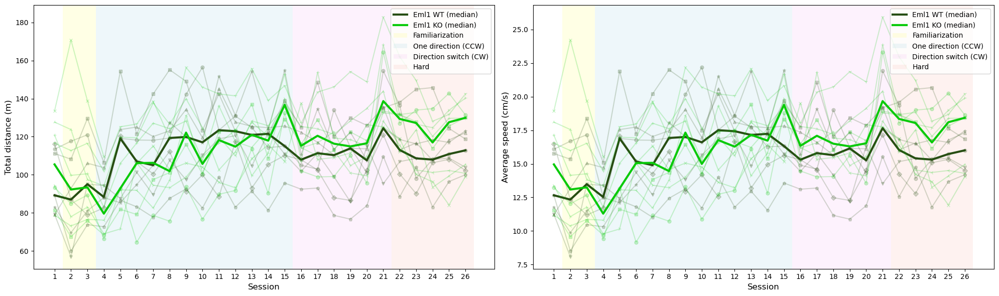

In [59]:
# Plot: total distance
fig, axs = plt.subplots(1,2,figsize=(20, 6))

plot_metric_evolution_between_groups(axs[0], total_distances, Eml1_groups, Eml1_colors, ylabel="Total distance (m)")
plot_metric_evolution_between_groups(axs[1], average_speeds, Eml1_groups, Eml1_colors, ylabel="Average speed (cm/s)")

plt.tight_layout()
plt.show()


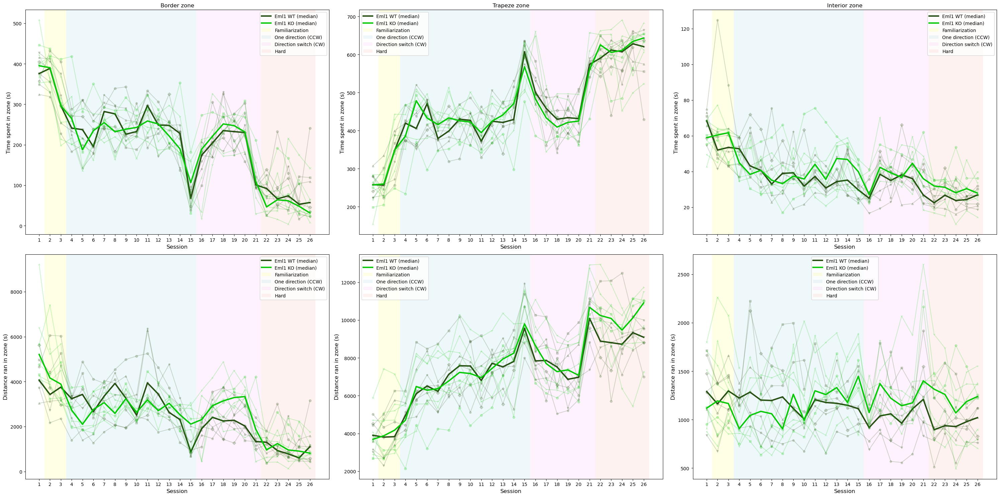

In [61]:
# Plots: time & distance in border/interior/trapeze
fig, axs = plt.subplots(2,3,figsize=(30, 15))

plot_metric_evolution_between_groups(axs[0,0], time_border_dict, Eml1_groups, Eml1_colors, ylabel="Time spent in zone (s)", title="Border zone")
plot_metric_evolution_between_groups(axs[0,1], time_trapeze_dict, Eml1_groups, Eml1_colors, ylabel="Time spent in zone (s)", title="Trapeze zone")
plot_metric_evolution_between_groups(axs[0,2], time_interior_dict, Eml1_groups, Eml1_colors, ylabel="Time spent in zone (s)", title="Interior zone")
plot_metric_evolution_between_groups(axs[1,0], distance_border_dict, Eml1_groups, Eml1_colors, ylabel="Distance ran in zone (s)")
plot_metric_evolution_between_groups(axs[1,1], distance_trapeze_dict, Eml1_groups, Eml1_colors, ylabel="Distance ran in zone (s)")
plot_metric_evolution_between_groups(axs[1,2], distance_interior_dict, Eml1_groups, Eml1_colors, ylabel="Distance ran in zone (s)")

plt.tight_layout()
plt.show()


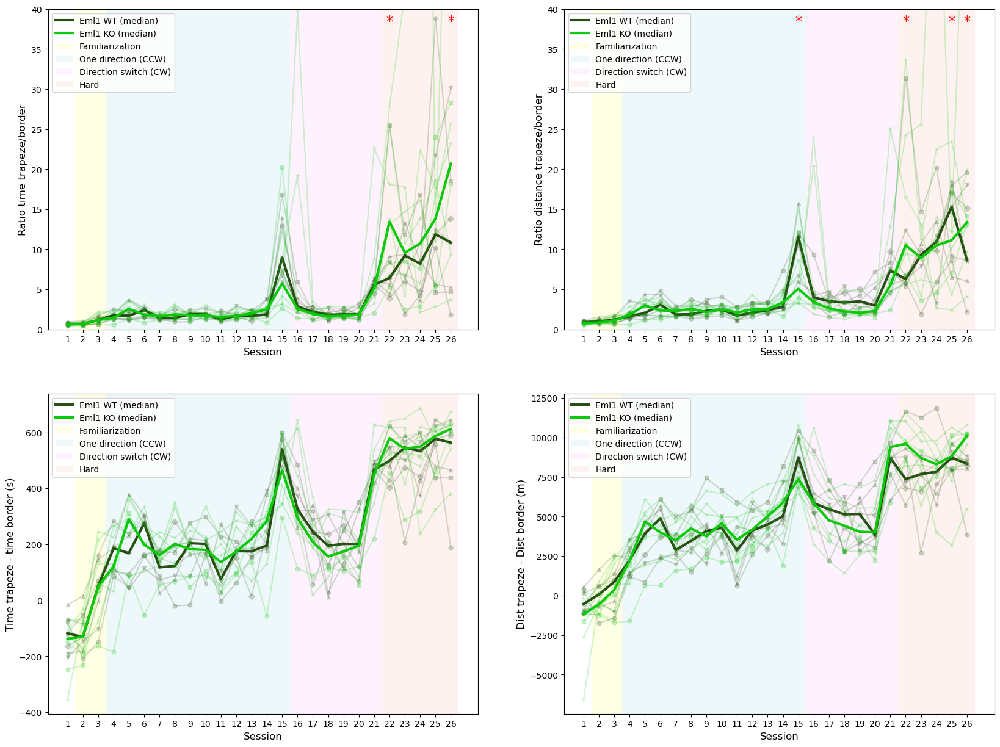

In [80]:
# Plots: ratios of time & distance in border/interior/trapeze
fig, axs = plt.subplots(2,2,figsize=(20, 15))

plot_metric_evolution_between_groups(axs[0,0], ratio_time_trapeze_over_border, Eml1_groups, Eml1_colors, ylabel="Ratio time trapeze/border", ylim=(0,40))
plot_metric_evolution_between_groups(axs[0,1], ratio_distance_trapeze_over_border, Eml1_groups, Eml1_colors, ylabel="Ratio distance trapeze/border", ylim=(0,40))
plot_metric_evolution_between_groups(axs[1,0], time_trapeze_minus_border, Eml1_groups, Eml1_colors, ylabel="Time trapeze - time border (s)")
plot_metric_evolution_between_groups(axs[1,1], distance_trapeze_minus_border, Eml1_groups, Eml1_colors, ylabel="Dist trapeze - Dist border (m)")

# plt.tight_layout()
plt.show()


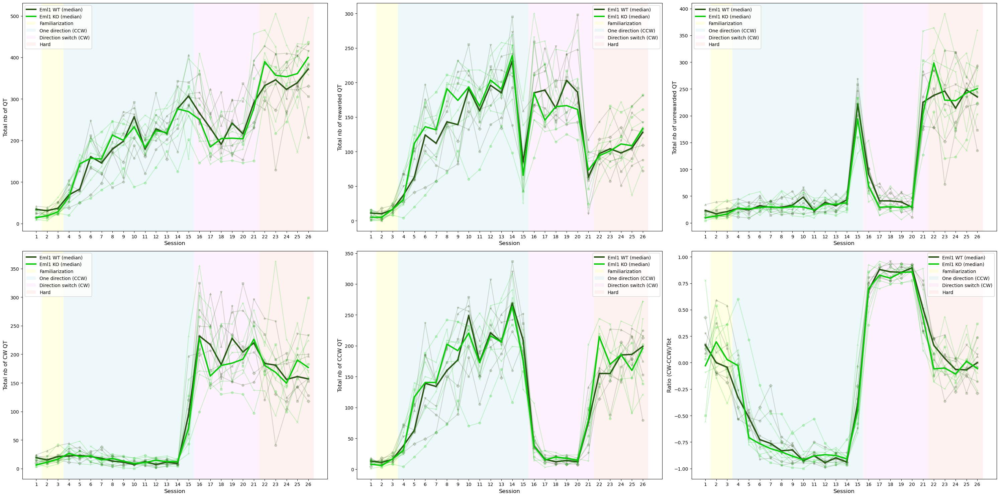

In [63]:
# Plots: nb of QT (rew/unrew/CW/CCW/ratio)
fig, axs = plt.subplots(2,3,figsize=(30, 15))

plot_metric_evolution_between_groups(axs[0,0], total_QT_dict, Eml1_groups, Eml1_colors, ylabel="Total nb of QT")
plot_metric_evolution_between_groups(axs[0,1], total_QT_rewarded_dict, Eml1_groups, Eml1_colors, ylabel="Total nb of rewarded QT")
plot_metric_evolution_between_groups(axs[0,2], total_QT_unrewarded_dict, Eml1_groups, Eml1_colors, ylabel="Total nb of unrewarded QT")
plot_metric_evolution_between_groups(axs[1,0], total_CW_dict, Eml1_groups, Eml1_colors, ylabel="Total nb of CW QT")
plot_metric_evolution_between_groups(axs[1,1], total_CCW_dict, Eml1_groups, Eml1_colors, ylabel="Total nb of CCW QT")
plot_metric_evolution_between_groups(axs[1,2], ratio_CW_CCW_dict, Eml1_groups, Eml1_colors, ylabel="Ratio (CW-CCW)/Tot")

plt.tight_layout()
plt.show()


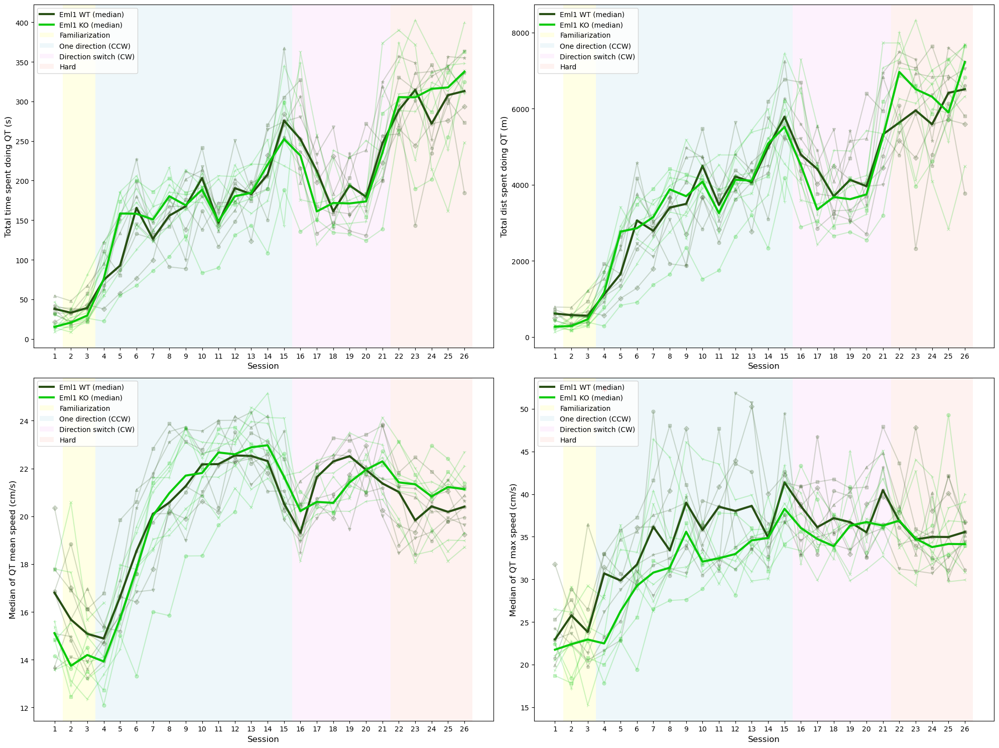

In [64]:
# Plots: time/dist/speed of QT
fig, axs = plt.subplots(2,2,figsize=(20, 15))

plot_metric_evolution_between_groups(axs[0,0], total_time_QT_dict, Eml1_groups, Eml1_colors, ylabel="Total time spent doing QT (s)")
plot_metric_evolution_between_groups(axs[0,1], total_distance_QT_dict, Eml1_groups, Eml1_colors, ylabel="Total dist spent doing QT (m)")
plot_metric_evolution_between_groups(axs[1,0], meanspeed_QT_dict, Eml1_groups, Eml1_colors, ylabel="Median of QT mean speed (cm/s)")
plot_metric_evolution_between_groups(axs[1,1], maxspeed_QT_dict, Eml1_groups, Eml1_colors, ylabel="Median of QT max speed (cm/s)")


plt.tight_layout()
plt.show()


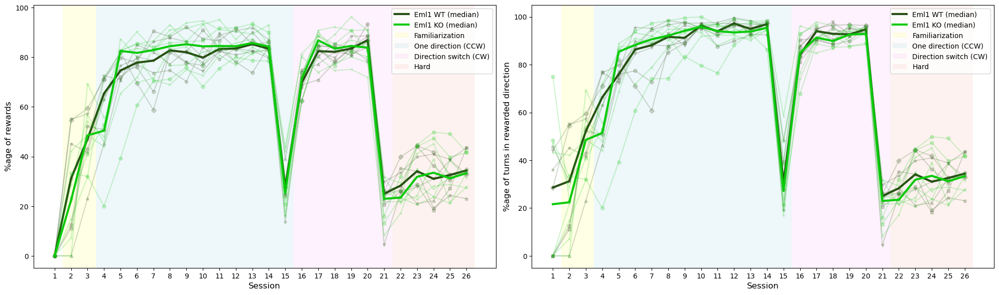

In [65]:
# Plots: %age of success
fig, axs = plt.subplots(1,2,figsize=(20, 6))

plot_metric_evolution_between_groups(axs[0], percentage_rewarded_dict, Eml1_groups, Eml1_colors, ylabel="%age of rewards")
plot_metric_evolution_between_groups(axs[1], success_percentage_dict, Eml1_groups, Eml1_colors, ylabel="%age of turns in rewarded direction")

plt.tight_layout()
plt.show()


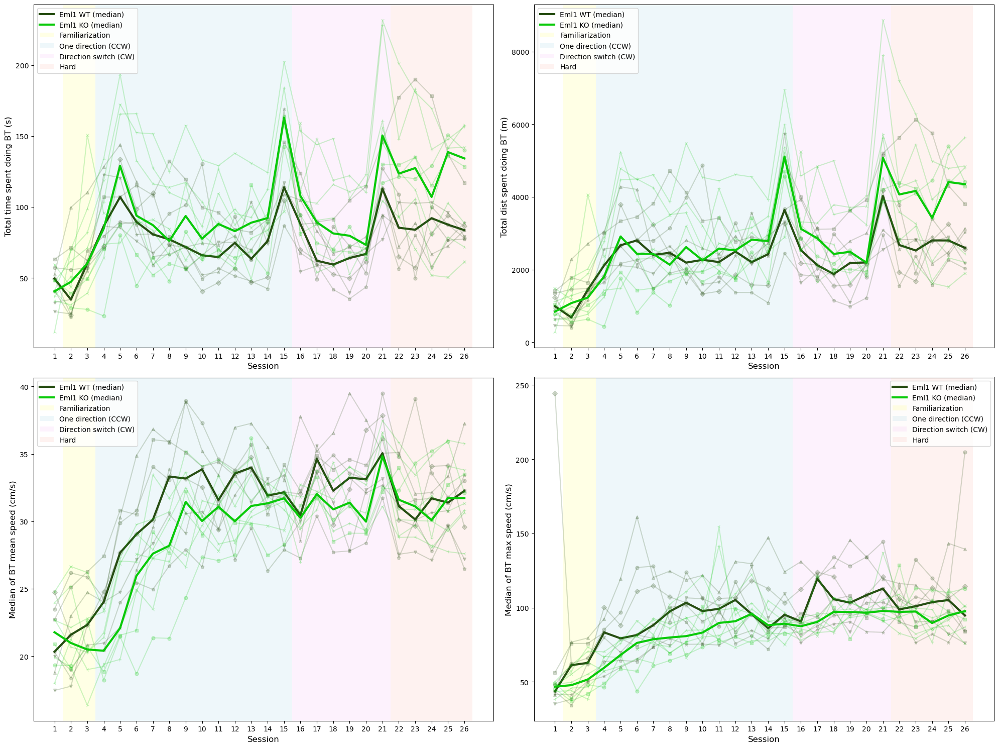

In [66]:
# Plots: time/dist/speed of BT
fig, axs = plt.subplots(2,2,figsize=(20, 15))

plot_metric_evolution_between_groups(axs[0,0], total_time_BT_dict, Eml1_groups, Eml1_colors, ylabel="Total time spent doing BT (s)")
plot_metric_evolution_between_groups(axs[0,1], total_distance_BT_dict, Eml1_groups, Eml1_colors, ylabel="Total dist spent doing BT (m)")
plot_metric_evolution_between_groups(axs[1,0], meanspeed_BT_dict, Eml1_groups, Eml1_colors, ylabel="Median of BT mean speed (cm/s)")
plot_metric_evolution_between_groups(axs[1,1], maxspeed_BT_dict, Eml1_groups, Eml1_colors, ylabel="Median of BT max speed (cm/s)")

plt.tight_layout()
plt.show()


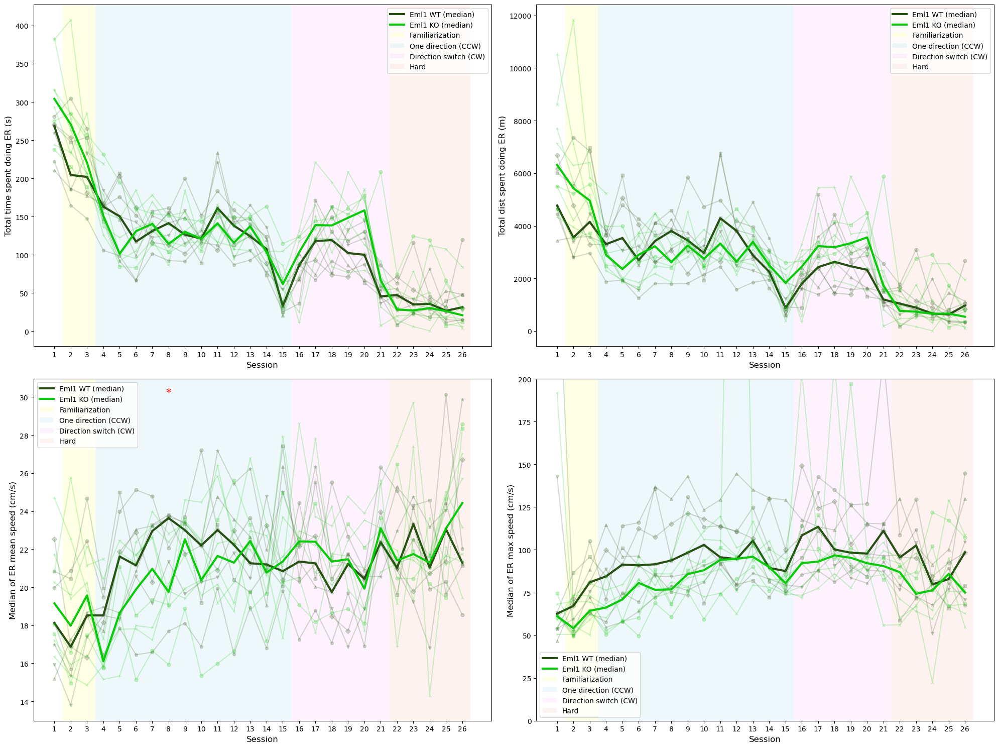

In [81]:
# Plots: time/dist/speed of ER
fig, axs = plt.subplots(2,2,figsize=(20, 15))

plot_metric_evolution_between_groups(axs[0,0], total_time_ER_dict, Eml1_groups, Eml1_colors, ylabel="Total time spent doing ER (s)")
plot_metric_evolution_between_groups(axs[0,1], total_distance_ER_dict, Eml1_groups, Eml1_colors, ylabel="Total dist spent doing ER (m)")
plot_metric_evolution_between_groups(axs[1,0], meanspeed_ER_dict, Eml1_groups, Eml1_colors, ylabel="Median of ER mean speed (cm/s)")
plot_metric_evolution_between_groups(axs[1,1], maxspeed_ER_dict, Eml1_groups, Eml1_colors, ylabel="Median of ER max speed (cm/s)", ylim=(0,200))

plt.tight_layout()
plt.show()


### Analyzes of RhoA groups

In [68]:
# List of all mice and their sessions

RhoA_mice_list: list[str] = ["MOURhoA_2","MOURhoA_5","MOURhoA_6","MOURhoA_8","MOURhoA_9","MOURhoA_12","MOURhoA_14",
                            "MOURhoA_1","MOURhoA_3","MOURhoA_4","MOURhoA_7","MOURhoA_10","MOURhoA_11","MOURhoA_13"]

session_list = {}
for mouse in RhoA_mice_list:
    mouse_folder = os.path.join(path_to_data_folder,mouse)
    session_list[mouse] = sorted([name for name in os.listdir(mouse_folder)
                           if os.path.isdir(os.path.join(mouse_folder, name))
                           and name.startswith('MOU')])
    nb_sessions = len(session_list[mouse])
    # print(f'Hello, I\'m {mouse}! I have foraged for {nb_sessions} sessions')

In [69]:
# Groups and colormaps

RhoA_WT: list[str] = ["MOURhoA_2","MOURhoA_5","MOURhoA_6","MOURhoA_8","MOURhoA_9","MOURhoA_12","MOURhoA_14"]
RhoA_KO: list[str] = ["MOURhoA_1","MOURhoA_3","MOURhoA_4","MOURhoA_7","MOURhoA_10","MOURhoA_11","MOURhoA_13"]

RhoA_males: list[str] = [] # To define with Aurelien
RhoA_females: list[str] = [] # To define with Aurelien

RhoA_groups = {
    "RhoA WT": RhoA_WT,
    "RhoA KO": RhoA_KO
}

RhoA_colors = {
    "RhoA WT": "#750031",
    "RhoA KO": "#f1108a"
}


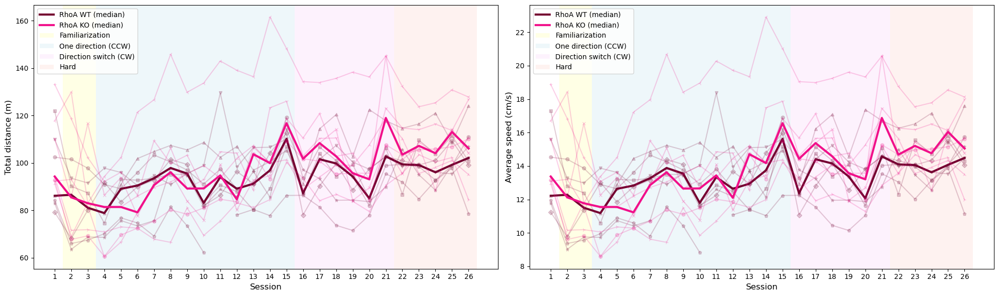

In [70]:
# Plot: total distance

fig, axs = plt.subplots(1,2,figsize=(20, 6))

plot_metric_evolution_between_groups(axs[0], total_distances, RhoA_groups, RhoA_colors, ylabel="Total distance (m)")
plot_metric_evolution_between_groups(axs[1], average_speeds, RhoA_groups, RhoA_colors, ylabel="Average speed (cm/s)")

plt.tight_layout()
plt.show()


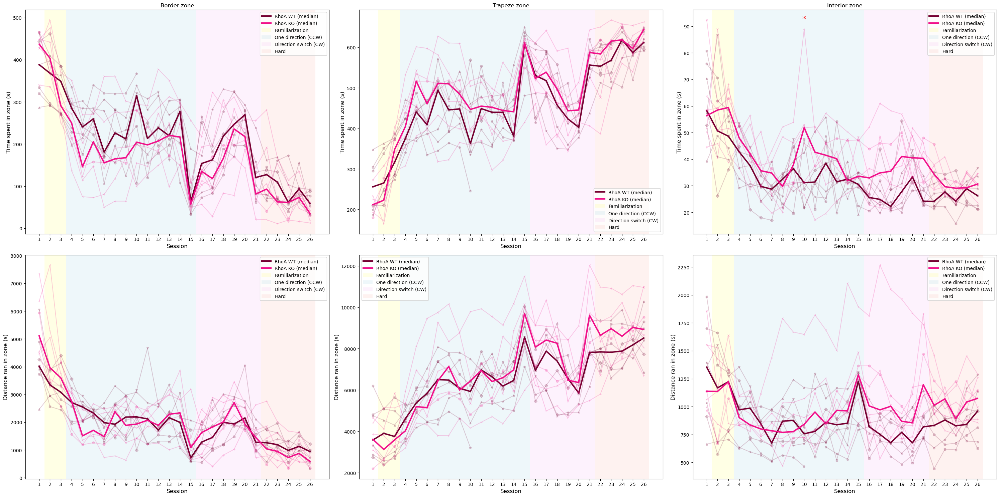

In [71]:
# Plots: time & distance in border/interior/trapeze
fig, axs = plt.subplots(2,3,figsize=(30, 15))

plot_metric_evolution_between_groups(axs[0,0], time_border_dict, RhoA_groups, RhoA_colors, ylabel="Time spent in zone (s)", title="Border zone")
plot_metric_evolution_between_groups(axs[0,1], time_trapeze_dict, RhoA_groups, RhoA_colors, ylabel="Time spent in zone (s)", title="Trapeze zone")
plot_metric_evolution_between_groups(axs[0,2], time_interior_dict, RhoA_groups, RhoA_colors, ylabel="Time spent in zone (s)", title="Interior zone")
plot_metric_evolution_between_groups(axs[1,0], distance_border_dict, RhoA_groups, RhoA_colors, ylabel="Distance ran in zone (s)")
plot_metric_evolution_between_groups(axs[1,1], distance_trapeze_dict, RhoA_groups, RhoA_colors, ylabel="Distance ran in zone (s)")
plot_metric_evolution_between_groups(axs[1,2], distance_interior_dict, RhoA_groups, RhoA_colors, ylabel="Distance ran in zone (s)")

plt.tight_layout()
plt.show()


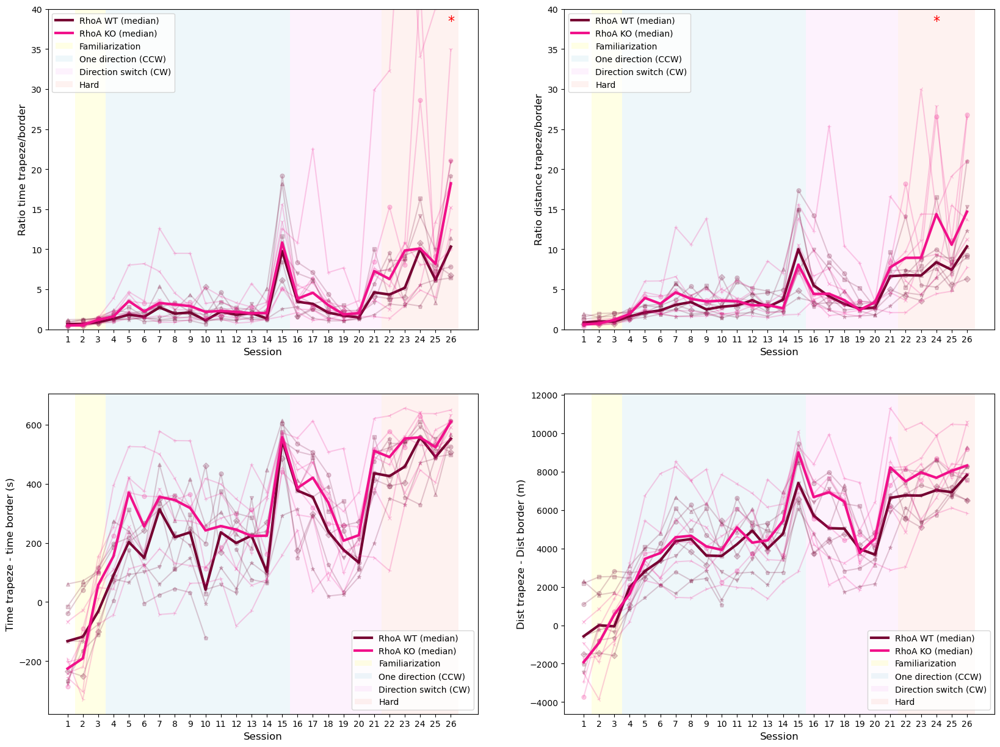

In [72]:
# Plots: ratios of time & distance in border/interior/trapeze
fig, axs = plt.subplots(2,2,figsize=(20, 15))

plot_metric_evolution_between_groups(axs[0,0], ratio_time_trapeze_over_border, RhoA_groups, RhoA_colors, ylabel="Ratio time trapeze/border", ylim=(0,40))
plot_metric_evolution_between_groups(axs[0,1], ratio_distance_trapeze_over_border, RhoA_groups, RhoA_colors, ylabel="Ratio distance trapeze/border", ylim=(0,40))
plot_metric_evolution_between_groups(axs[1,0], time_trapeze_minus_border, RhoA_groups, RhoA_colors, ylabel="Time trapeze - time border (s)")
plot_metric_evolution_between_groups(axs[1,1], distance_trapeze_minus_border, RhoA_groups, RhoA_colors, ylabel="Dist trapeze - Dist border (m)")

# plt.tight_layout()
plt.show()


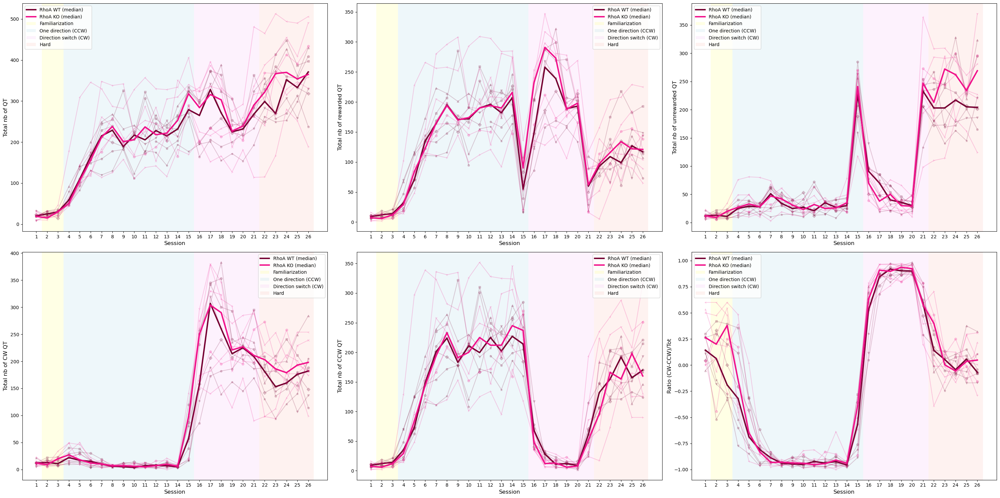

In [73]:
# Plots: nb of QT (rew/unrew/CW/CCW/ratio)
fig, axs = plt.subplots(2,3,figsize=(30, 15))

plot_metric_evolution_between_groups(axs[0,0], total_QT_dict, RhoA_groups, RhoA_colors, ylabel="Total nb of QT")
plot_metric_evolution_between_groups(axs[0,1], total_QT_rewarded_dict, RhoA_groups, RhoA_colors, ylabel="Total nb of rewarded QT")
plot_metric_evolution_between_groups(axs[0,2], total_QT_unrewarded_dict, RhoA_groups, RhoA_colors, ylabel="Total nb of unrewarded QT")
plot_metric_evolution_between_groups(axs[1,0], total_CW_dict, RhoA_groups, RhoA_colors, ylabel="Total nb of CW QT")
plot_metric_evolution_between_groups(axs[1,1], total_CCW_dict, RhoA_groups, RhoA_colors, ylabel="Total nb of CCW QT")
plot_metric_evolution_between_groups(axs[1,2], ratio_CW_CCW_dict, RhoA_groups, RhoA_colors, ylabel="Ratio (CW-CCW)/Tot")

plt.tight_layout()
plt.show()


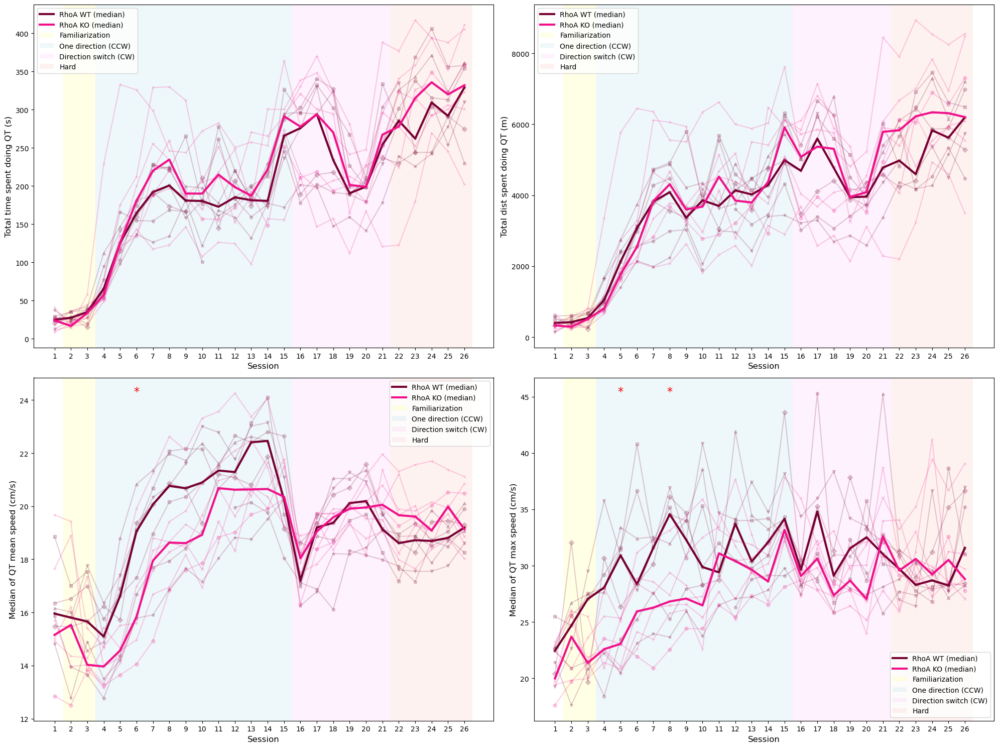

In [74]:
# Plots: time/dist/speed of QT
fig, axs = plt.subplots(2,2,figsize=(20, 15))

plot_metric_evolution_between_groups(axs[0,0], total_time_QT_dict, RhoA_groups, RhoA_colors, ylabel="Total time spent doing QT (s)")
plot_metric_evolution_between_groups(axs[0,1], total_distance_QT_dict, RhoA_groups, RhoA_colors, ylabel="Total dist spent doing QT (m)")
plot_metric_evolution_between_groups(axs[1,0], meanspeed_QT_dict, RhoA_groups, RhoA_colors, ylabel="Median of QT mean speed (cm/s)")
plot_metric_evolution_between_groups(axs[1,1], maxspeed_QT_dict, RhoA_groups, RhoA_colors, ylabel="Median of QT max speed (cm/s)")


plt.tight_layout()
plt.show()


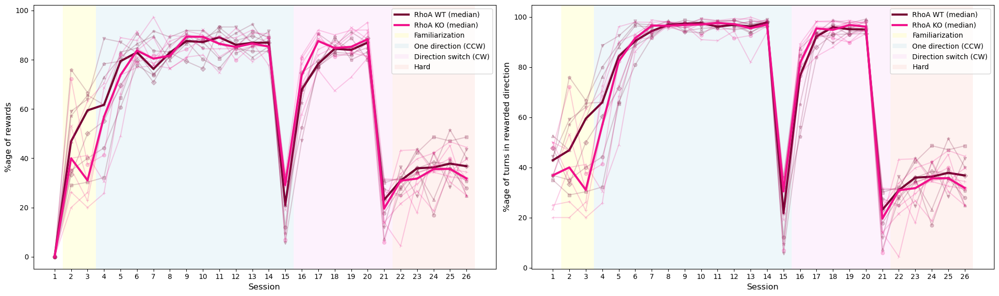

In [75]:
# Plots: %age of success
fig, axs = plt.subplots(1,2,figsize=(20, 6))

plot_metric_evolution_between_groups(axs[0], percentage_rewarded_dict, RhoA_groups, RhoA_colors, ylabel="%age of rewards")
plot_metric_evolution_between_groups(axs[1], success_percentage_dict, RhoA_groups, RhoA_colors, ylabel="%age of turns in rewarded direction")

plt.tight_layout()
plt.show()


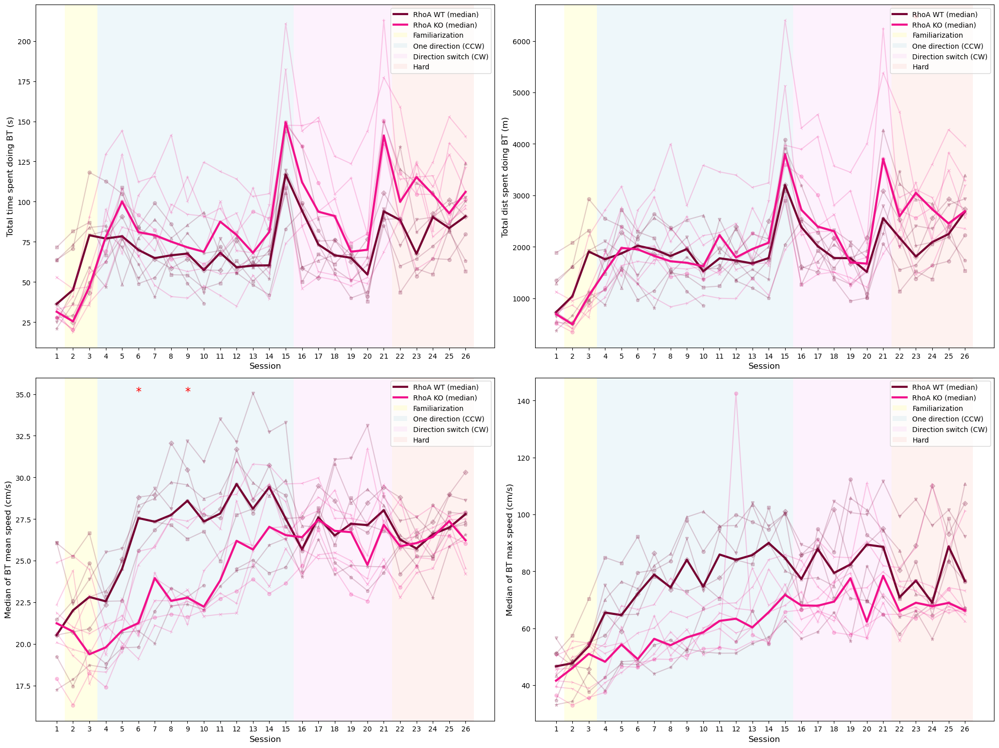

In [76]:
# Plots: time/dist/speed of BT
fig, axs = plt.subplots(2,2,figsize=(20, 15))

plot_metric_evolution_between_groups(axs[0,0], total_time_BT_dict, RhoA_groups, RhoA_colors, ylabel="Total time spent doing BT (s)")
plot_metric_evolution_between_groups(axs[0,1], total_distance_BT_dict, RhoA_groups, RhoA_colors, ylabel="Total dist spent doing BT (m)")
plot_metric_evolution_between_groups(axs[1,0], meanspeed_BT_dict, RhoA_groups, RhoA_colors, ylabel="Median of BT mean speed (cm/s)")
plot_metric_evolution_between_groups(axs[1,1], maxspeed_BT_dict, RhoA_groups, RhoA_colors, ylabel="Median of BT max speed (cm/s)")

plt.tight_layout()
plt.show()


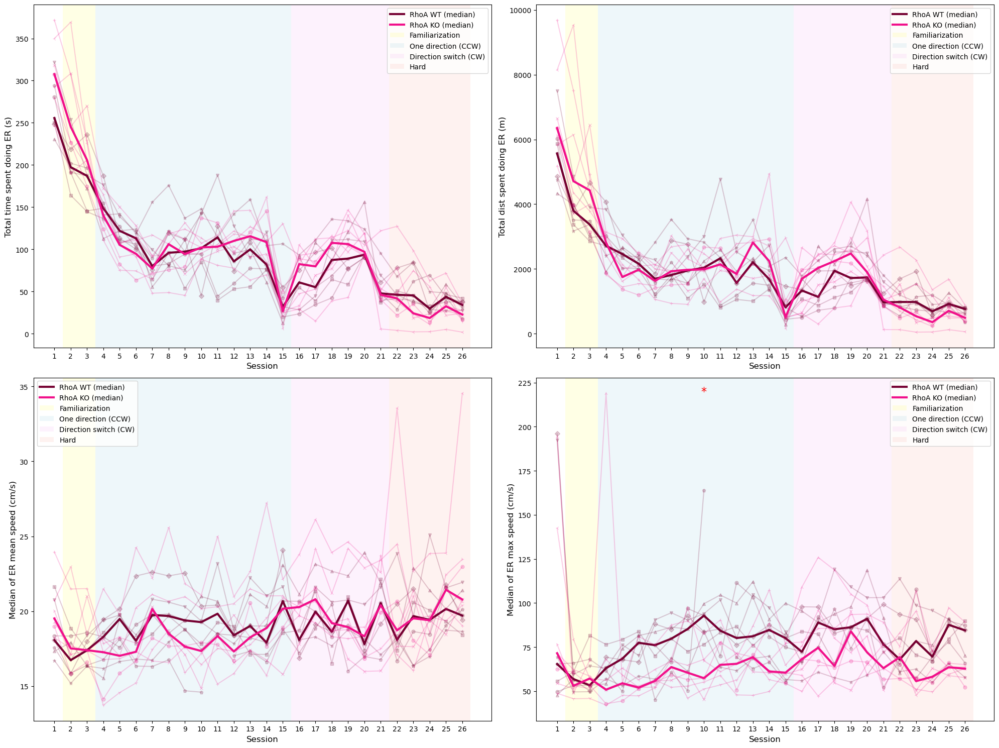

In [77]:
# Plots: time/dist/speed of ER
fig, axs = plt.subplots(2,2,figsize=(20, 15))

plot_metric_evolution_between_groups(axs[0,0], total_time_ER_dict, RhoA_groups, RhoA_colors, ylabel="Total time spent doing ER (s)")
plot_metric_evolution_between_groups(axs[0,1], total_distance_ER_dict, RhoA_groups, RhoA_colors, ylabel="Total dist spent doing ER (m)")
plot_metric_evolution_between_groups(axs[1,0], meanspeed_ER_dict, RhoA_groups, RhoA_colors, ylabel="Median of ER mean speed (cm/s)")
plot_metric_evolution_between_groups(axs[1,1], maxspeed_ER_dict, RhoA_groups, RhoA_colors, ylabel="Median of ER max speed (cm/s)")

plt.tight_layout()
plt.show()


### Compute new metrics: Frechet distance of QT and time to reach 80% of rewards

In [78]:
# Cell to compute Frechet distance inside a pickle
# Run one time only
---------------------------------------------------

first_and_last_session_indexes = [0,25]
mice_to_analyse = mice_list

def towers_coordinates_as_dictionnary(towers_coordinates_cm):
    
    """
    Converts a dictionary of tower coordinates into a structured dictionary 
    where each tower's coordinates are labeled with explicit corner names.

    Arguments:
        towers_coordinates_cm (dict): Dictionary where keys are tower names and 
                                      values are lists/tuples of four coordinates.

    Returns:
        dict: A dictionary mapping tower names to their respective coordinates, 
              labeled as 'NW' (North-West), 'NE' (North-East), 'SE' (South-East), 
              and 'SW' (South-West).
    """

    # Initialize a dictionary to store labeled coordinates
    towers_coordinates_as_dict = {}

    # Predefined corner names in the order expected from input coordinates
    corner_names = ['NW', 'NE', 'SE', 'SW']

    # Map each tower's coordinates to its corresponding corner names
    for tower, coordinates in towers_coordinates_cm.items():
        towers_coordinates_as_dict[tower] = {
            corner_names[i]: coord for i, coord in enumerate(coordinates)
        }

    return towers_coordinates_as_dict

def get_tower_and_corner(run_around_tower):

    """
    Get the label of the tower and corner around wich the run around tower is happened
    based on the second and third elements saved in run_around_tower: 'N' for north, 'S' for south, 'E' for east, 'W' for west.
    
    Argument:
        run_around_tower (list): a list containing information about a run around tower

    Returns:
        str: Name of the tower around which the run occured
        str: A two character string. The first character is the name of the starting trapeze,
             the last character is the name of the ending trapeze  
    """
    
    # Extract tower name, starting name and ending trapeze name 
    tower_name = run_around_tower[1][0]
    start_trapeze = run_around_tower[1][1]
    end_trapeze = run_around_tower[2][1]
    
    # Determine the corner based on the start and end faces
    if start_trapeze == 'W' and end_trapeze == 'S':
        corner = 'SW'
    elif start_trapeze == 'S' and end_trapeze == 'E':
        corner = 'SE'
    elif start_trapeze == 'E' and end_trapeze == 'N':
        corner = 'NE'
    elif start_trapeze == 'N' and end_trapeze == 'W':
        corner = 'NW'
    elif start_trapeze == 'W' and end_trapeze == 'N':
        corner = 'NW'
    elif start_trapeze == 'N' and end_trapeze == 'E':
        corner = 'NE'
    elif start_trapeze == 'E' and end_trapeze == 'S':
        corner = 'SE'
    elif start_trapeze == 'S' and end_trapeze == 'W':
        corner = 'SW'
    else:
        corner = None  # Handle unexpected cases
    
    return tower_name, corner

def rotate_sw_trajectory_90_ccw(trajectory):
    
    """
    Rotates the input trajectory of 90° in counter-clockwise direction.

    Argument:
        trajectory (numpy.ndarray): A 2D numpy.ndarray of shape (2, X).

    Returns:
        numpy.ndarray: trajectory rotated by 90° counter-clockwise

    """
    
    # Define the roation matrix
    rotation_matrix = np.array([[0, -1], [1, 0]])
    
    # Returns the matrix product of the rotation matrix and the trajectory 
    return rotation_matrix @ trajectory

def rotate_nw_trajectory_180_ccw(trajectory):

    """
    Rotates the input trajectory of 180° in counter-clockwise direction.

    Argument:
        trajectory (numpy.ndarray): A 2D numpy.ndarray of shape (2, X).

    Returns:
        numpy.ndarray: trajectory rotated by 180° counter-clockwise

    """

    return -trajectory

def rotate_ne_trajectory_270_ccw(trajectory):
    
    """
    Rotates the input trajectory of 270° in counter-clockwise direction.

    Argument:
        trajectory (numpy.ndarray): A 2D numpy.ndarray of shape (2, X).

    Returns:
        numpy.ndarray: trajectory rotated by 270° counter-clockwise

    """
    
    # Define the roation matrix
    rotation_matrix = np.array([[0, 1], [-1, 0]])

    # Returns the matrix product of the rotation matrix and the trajectory 
    return rotation_matrix @ trajectory

def compute_frechet_distances(runs_list):

    """
    This function takes a list of trajectories of dimensions (2,N), computes the Fréchet distance 
    between each pairs of trajectories, and returns the median of those distances.
    
    Arguments:
        runs_list (list): List of trajectories of dimensions (2,N)

    Return:
        (float): Median of the Fréchet distances of all trajectories pairs
    
    """

    # Create an empty list that will contain the Fréchet distances of all trajectories pairs
    frechet_distances_list = []

    # Iterate on all trajectories
    for i in range(len(runs_list)):

        # Transpose the trajectory
        # This step is necessary as the function that computes the Fréchet distance takes as an argument trajectories of dimensions (N,2)
        traj_points_a = np.transpose(runs_list[i])

        # Iterate on every trajectories of higher ranks to create trajectories pairs
        # We do that so that no pairs is counted twice, as the Fréchet distance between trajectory A and B is the same as between B and A
        for j in range(i+1, len(runs_list)):

            # Transpose the trajectory
            traj_points_b = np.transpose(runs_list[j])

            # Compute the Fréchet distance for the current pair of trajectories
            frechet_distance = sm.frechet_dist(traj_points_a,traj_points_b)

            # Store the result in a list
            frechet_distances_list.append(frechet_distance)

    # Return the median of the list of Fréchet distances
    return frechet_distances_list

# Initialize a dictionary to store all trajectories for each mouse, with empty lists for each session
mice_alltrajectories_persession = {mouse: {} for mouse in mice_to_analyse}

# Initialize a dictionary to store realigned and rotated trajectories for each mouse, with empty dictionaries for each session
trajectories_per_session_realigned_rotated = {mouse: {} for mouse in mice_to_analyse}

# Loop through each mouse in the list of mice to realign all their turns trajectory
for mouse in mice_to_analyse:
    # Define the folder path for the current mouse
    folder_path_mouse_to_process = os.path.join(path_to_data_folder, mouse)

    # Get a sorted list of session folders for the current mouse
    sessions_to_process = sorted([name for name in os.listdir(folder_path_mouse_to_process)
                                  if os.path.isdir(os.path.join(folder_path_mouse_to_process, name))
                                  and name.startswith('MOU')])

    sessions_to_process = sessions_to_process[first_and_last_session_indexes[0]:first_and_last_session_indexes[1]]

    # Get the number of sessions to process
    nb_sessions = len(sessions_to_process)
    print(f'Processing mouse {mouse}. There is/are {nb_sessions} sessions to process:')
    print(sessions_to_process, '\n')

    # Loop through each session for the current mouse to realign all the turns trajectory from those sessions
    for session_index, session_to_process in enumerate(sessions_to_process):
        print(f'Getting the run trajectory of session {session_index}')

        # Define the path to the pickle file for the current session
        output_pickle_filename = f"{session_to_process}_basic_processing_output.pickle"
        output_pickle_filepath = os.path.join(folder_path_mouse_to_process, session_to_process, output_pickle_filename)

          # Check if the pickle file exists
        if not os.path.exists(output_pickle_filepath):
            print(f'Pickle file does not exist for session {session_to_process}, skipping .....')
            continue
        
        # Load the data from the pickle file
        with open(output_pickle_filepath, 'rb') as file:
            session_data = pickle.load(file)

        # Initialize entries for the current session in the dictionaries
        mice_alltrajectories_persession[mouse][session_index] = []
        trajectories_per_session_realigned_rotated[mouse][session_index] = {'CW':[], 'CCW':[]}

        # Get the runs around the tower for the current session
        runs_around_tower = session_data['all_epochs']['run_around_tower']
        # Get the trajectory of the mouse
        positions = np.array(session_data['positions'])

        # Get the tower coordinates and convert them to a dictionary format
        towers_coordinates_cm = session_data['towers_coordinates_cm']
        towers_coordinates_as_dict = towers_coordinates_as_dictionnary(towers_coordinates_cm)

        # Loop through each run around the tower to realign them
        for run_around_tower in runs_around_tower:
            # Only process runs around tower where there was only one trapeze switch 
            if run_around_tower[3]['num_trapezeswitch'] == 1:
                # Extract the run trajectory
                run_trajectory = positions[:, run_around_tower[0][0]:run_around_tower[0][1]]
                mice_alltrajectories_persession[mouse][session_index].append(run_trajectory)

                # Get the tower and corner names
                tower_name, corner = get_tower_and_corner(run_around_tower)

                # Access tower and corner coordinates from the dictionary
                if tower_name in towers_coordinates_as_dict and corner in towers_coordinates_as_dict[tower_name]:
                    this_corner_coordinates = towers_coordinates_as_dict[tower_name][corner]
                else:
                    print(f"Invalid tower or corner: {tower_name}, {corner}")
                    continue

                # Extract the trajectory slice based on the start and end time indices
                start_idx, end_idx = run_around_tower[0]
                this_trajectory = positions[:, start_idx:end_idx]

                # Get the corner's reference coordinates (X and Y)
                newXreference = this_corner_coordinates[0]
                newYreference = this_corner_coordinates[1]

                # Shift the trajectory to reference the new corner coordinates
                this_trajectory[0, :] -= newXreference  # Shift X coordinates
                this_trajectory[1, :] -= newYreference  # Shift Y coordinates

                # Rotate the trajectory based on the corner
                if corner == 'SW':
                    this_trajectory = rotate_sw_trajectory_90_ccw(this_trajectory)
                elif corner == 'NW':
                    this_trajectory = rotate_nw_trajectory_180_ccw(this_trajectory)
                elif corner == 'NE':
                    this_trajectory = rotate_ne_trajectory_270_ccw(this_trajectory)

                # Get the direction (CW or CCW)
                direction = run_around_tower[3]['direction']

                # Append the transformed trajectory to the appropriate list based on direction
                trajectories_per_session_realigned_rotated[mouse][session_index][direction].append(this_trajectory)

#modified by david to try to save trajecotry Fréchet distance
overwritte_previous_frechet_distances=False
# Initialize dictionaries to store overall Fréchet distances per session for each direction (CW and CCW)
overall_trajectory_frechet_distances_per_session = {mouse: {'CW': [], 'CCW': []} for mouse in trajectories_per_session_realigned_rotated}
overall_cw_turns_frechet_distances_per_session = {mouse: [] for mouse in trajectories_per_session_realigned_rotated}
overall_ccw_turns_frechet_distances_per_session = {mouse: [] for mouse in trajectories_per_session_realigned_rotated}


allsessionnumber = list(range(first_and_last_session_indexes[0]+1, first_and_last_session_indexes[1]+1))

# Define the directions to process
directions = ['CW', 'CCW']

# Loop through each mouse in the list of mice to analyze
for mouse in mice_to_analyse:

     # Define the folder path for the current mouse
    folder_path_mouse_to_process = os.path.join(path_to_data_folder, mouse)


    # Get a sorted list of session folders for the current mouse
    sessions_to_process = sorted([name for name in os.listdir(folder_path_mouse_to_process)
                                  if os.path.isdir(os.path.join(folder_path_mouse_to_process, name))
                                  and name.startswith('MOU')])

    sessions_to_process = sessions_to_process[first_and_last_session_indexes[0]:first_and_last_session_indexes[1]]

     # Get the number of sessions to process for the current mouse
    nb_sessions = len(sessions_to_process)
    print(f'Processing mouse {mouse}. There is/are {nb_sessions} sessions to process:')
    print(sessions_to_process, '\n')

    # Loop through each session for the current mouse
    for session_index in trajectories_per_session_realigned_rotated[mouse]:
        
        # Define the pickle filename to save the realigned and rotated trajectories for this session
        session_to_process = sessions_to_process[session_index]
        overall_trajectory_frechet_distances_per_session_pickle_filename = (
            f"{session_to_process}_overall_trajectory_frechet_distances_per_session.pickle"
        )
        overall_trajectory_frechet_distances_per_session_pickle_filepath = os.path.join(
            folder_path_mouse_to_process, session_to_process, overall_trajectory_frechet_distances_per_session_pickle_filename
        )

        if not os.path.exists(overall_trajectory_frechet_distances_per_session_pickle_filepath) or overwritte_previous_frechet_distances:
            
            this_session_frechet_distance = {'CW': None, 'CCW': None}
        
            print(f"Processing session index: {session_index} for direction: {direction}")
            
            # Loop through each direction (CW and CCW)
            for direction in directions:
                # Access the realigned trajectories for the current session and direction
                realigned_trajectories = trajectories_per_session_realigned_rotated[mouse][session_index][direction]

                # If there are no trajectories for the current direction, skip the session
                if not realigned_trajectories:
                    print(f"No trajectories for {direction} in session {session_index}, skipping...")
                    overall_trajectory_frechet_distances_per_session[mouse][direction].append([allsessionnumber[session_index], np.nan])
                    this_session_frechet_distance[direction]=np.nan
                    continue

                # Compute the number of realigned trajectories
                number_of_realigned_trajectories = len(realigned_trajectories)

                # If there are fewer than 5 trajectories, skip the session
                if number_of_realigned_trajectories < 5:
                    print(f"Less than 5 trajectories for {direction} in session {session_index}, skipping...")
                    overall_trajectory_frechet_distances_per_session[mouse][direction].append([allsessionnumber[session_index], np.nan])
                    if direction=='CW':
                        this_session_frechet_distance['CW']=np.nan
                    if direction=='CCW':
                        this_session_frechet_distance['CCW']=np.nan
                    continue
                else:

                    # Compute Fréchet distance 
                    frechet_distances = compute_frechet_distances(trajectories_per_session_realigned_rotated[mouse][session_index][direction])

                    # Compute the overall Fréchet distance (median of pairwise frechet_distances)
                    overall_frechet_distance = np.nanmedian(frechet_distances)

                    # Append the overall trajectory Fréchet distance for the current direction and session
                    overall_trajectory_frechet_distances_per_session[mouse][direction].append([allsessionnumber[session_index], overall_frechet_distance])

                    if direction=='CW':
                        this_session_frechet_distance['CW']=overall_frechet_distance
                    if direction=='CCW':
                        this_session_frechet_distance['CCW']=overall_frechet_distance

            
            # Save the dictionary for CW and CCW trajectories
            with open(overall_trajectory_frechet_distances_per_session_pickle_filepath, 'wb') as file:
                pickle.dump(this_session_frechet_distance, file)

            print(f"Saved trajectories Fréchet distances for {mouse}, session {session_to_process} at {overall_trajectory_frechet_distances_per_session_pickle_filepath}")    
        else:
            with open(overall_trajectory_frechet_distances_per_session_pickle_filepath, 'rb') as file:
                this_session_frechet_distance = pickle.load(file)  # Preserve existing values
            
            print(f"Loaded existing Fréchet distances for {mouse}, session {session_to_process}")
            for direction in directions:
                overall_frechet_distance=this_session_frechet_distance[direction]
                overall_trajectory_frechet_distances_per_session[mouse][direction].append([allsessionnumber[session_index], overall_frechet_distance])

    # Store the all the Fréchet distances and session in the corresponding direction's dictionnary
    for direction in directions:
        if direction=='CW':
            overall_cw_turns_frechet_distances_per_session[mouse] = overall_trajectory_frechet_distances_per_session[mouse][direction]
        if direction=='CCW':
            overall_ccw_turns_frechet_distances_per_session[mouse] = overall_trajectory_frechet_distances_per_session[mouse][direction]


SyntaxError: invalid syntax (280399425.py, line 3)

In [ ]:
# Computation of rewarded/unrewarded/ratio/threshold 80%
def finding_mouse_rewarded_direction(folder_path_mouse_to_process, session_index):
    
    """
    Determines the rewarded direction for the session corresponding to the input index of a given mouse. 
    This index is relative to the session position in the series of analysed sessions.
    This input index can have an offset. This is usefull if the sessions series analysed does not start with the first session. 
    
    Arguments:
        folder_path_mouse_to_process (str): Path to the folder containing mouse sessions folders.
        session_index (int): Index of the session that will be used to define the rewarded direction

    Returns:
        str: 'CW' (Clockwise) if the rewarded direction is 270 degrees,
             'CCW' (Counterclockwise) if the rewarded direction is 90 degrees,
             numpy.nan if reward delivery is not allowed 
             None if an error occurs or if both directions are rewarded.
    """
    
    # Get all session folders that start with 'MOU' and sort them
    sessions_to_process = sorted([name for name in os.listdir(folder_path_mouse_to_process)
                                  if os.path.isdir(os.path.join(folder_path_mouse_to_process, name))
                                  and name.startswith('MOU')])

    # Load data from the last session
    session_traj_df, session_turns_df, session_param_df = load_data(folder_path_mouse_to_process, sessions_to_process[session_index])

    # Extract rewarded direction in degrees
    rewarded_direction_degrees = session_param_df["potentialRewardedDirections"][0]

    # Check if reward delivery is allowed
    if session_param_df["allowRewardDelivery"][0]:

        # Determine the rewarded direction based on the extracted value
        if rewarded_direction_degrees == '[270]':
            rewarded_direction = 'CW'  # Clockwise

        elif rewarded_direction_degrees == '[90]':
            rewarded_direction = 'CCW'  # Counterclockwise
        
        elif rewarded_direction_degrees == '[90, 270]':
            rewarded_direction = 'both'  # Clockwise and Counterclockwise

        # Returns None if the rewarded direction entry in session_param_df is not recognized
        else:
            print('ERROR: Unexpected rewarded direction value:', rewarded_direction_degrees)
            return None  # Explicitly return None to indicate failure
    
    else:

        # Rewarded direction is set to X if reward delivery os not allowed
        rewarded_direction = 'X'

    return rewarded_direction

def cumulated_turns_time_profile(folder_path_mouse_to_process, session_to_process, rewarded_direction):
    """
    Computes the cumulative number of runs around a tower at each time a new run around a tower occurs, for a given session and a given mouse.

    Arguments:
        folder_path_mouse_to_process (str): Path to the folder containing mouse session data.
        session_to_process (str): Name of the session to be processed.
        reference_session_index (int): Index of the session that will be used to define the rewarded direction
        
    Returns:
        tuple: Two lists containing:
            - (good_turns_time, cumulated_good_turns): Sorted times and cumulative counts for turns in rewarding direction.
            - (bad_turns_time, cumulated_bad_turns): Sorted times and cumulative counts for turns in non-rewarded direction.
    """

    # Construct the path to the session pickle file
    output_pickle_filename = f"{session_to_process}_basic_processing_output.pickle"
    output_pickle_filepath = os.path.join(folder_path_mouse_to_process, session_to_process, output_pickle_filename)

    # Load session data from the pickle file
    with open(output_pickle_filepath, 'rb') as file:
        session_data = pickle.load(file)

    # Deep copy the list of turn epochs
    runs_around_tower = copy.deepcopy(session_data['all_epochs']['run_around_tower'])

    # Initialize lists to store filtered turns
    time_of_runsaroundtower_cw = []
    time_of_runsaroundtower_ccw = []

    # Iterate through each recorded turn around the tower
    for run_around_tower in runs_around_tower:

        # Categorize turns based on direction
        if run_around_tower[3]['direction'] == 'CW':
            time_of_runsaroundtower_cw.append(run_around_tower[4]['epoch_time'])
        elif run_around_tower[3]['direction'] == 'CCW':
            time_of_runsaroundtower_ccw.append(run_around_tower[4]['epoch_time'])

    # Sort the turn times for cumulative calculations
    CW_times_sorted = np.sort(time_of_runsaroundtower_cw)
    CCW_times_sorted = np.sort(time_of_runsaroundtower_ccw)

    # Compute cumulative counts for each direction
    CW_cumulative = np.arange(1, len(CW_times_sorted) + 1)
    CCW_cumulative = np.arange(1, len(CCW_times_sorted) + 1)
    
    # Assign good and bad turns based on the rewarded direction
    if rewarded_direction == 'CW':
        good_turns_time = CW_times_sorted
        bad_turns_time = CCW_times_sorted
        cumulated_good_turns = CW_cumulative
        cumulated_bad_turns = CCW_cumulative

    elif rewarded_direction == 'CCW':
        good_turns_time = CCW_times_sorted
        bad_turns_time = CW_times_sorted
        cumulated_good_turns = CCW_cumulative
        cumulated_bad_turns = CW_cumulative

    elif rewarded_direction == 'X':

        good_turns_time = np.ones(len(CCW_times_sorted))*np.nan
        bad_turns_time = np.ones(len(CW_times_sorted))*np.nan
        cumulated_good_turns = np.ones(len(CCW_cumulative))*np.nan
        cumulated_bad_turns = np.ones(len(CW_cumulative))*np.nan

    else:
        print('ERROR: Unexpected rewarded direction value')
        return None  # Explicitly return None to indicate an error

    return [good_turns_time, cumulated_good_turns], [bad_turns_time, cumulated_bad_turns]

def accumulation_threshold(cummulated_events_time, threshold_fraction=0.8):

    """
    Compute the first time point at which the cummulated number of event in cummulated_events_time
    is above a threshold, that is a fraction (80% by default) of the total number of events.
    
    Arguments:
        cummulated_events_time (list): list of time at which one event occurs.
        threshold_fraction (float, optional): fraction of the total number of event that will used as threshold. 

    Returns:
        float: first value in cummulated_events_time that is above the
        
    """

    # Compute the total number of events
    total_events = len(cummulated_events_time)

    # Initialise index of the first event
    i = 0

    # Compute the fraction of cummulated events
    fraction_of_events = (i+1)/total_events

    # Iterate while the fraction of cummulated events is lower than the threshold fraction 
    while fraction_of_events<threshold_fraction:

        # Increase the index
        i = i + 1
        # Update the fraction of cummulated events at the new index
        fraction_of_events = (i+1)/total_events

    # Return the first time in cummulated_events_time at which the fraction of cummulated events is higher than threshold_fraction.  
    return cummulated_events_time[i]

# Initialize dictionaries to store the various metrics for each mouse
mice_rewarded_tats_persession = {mouse: [] for mouse in mice_to_analyse}
mice_unrewarded_tats_persession = {mouse: [] for mouse in mice_to_analyse}
mice_cw_vs_ccw_norm_diff_persession = {mouse: [] for mouse in mice_to_analyse}

mice_tats_rewarded_dir_threshold_persession = {mouse: [] for mouse in mice_to_analyse}

# Iterate through each mouse to process its data
for mouse in mice_to_analyse:
    folder_path_mouse_to_process = os.path.join(path_to_data_folder, mouse)

    # Get the list of sessions for the current mouse
    sessions_to_process = sorted([name for name in os.listdir(folder_path_mouse_to_process)
                                  if os.path.isdir(os.path.join(folder_path_mouse_to_process, name))
                                  and name.startswith('MOU')])

    # limit the analysis to the subseet of session we want to analyse
    sessions_to_process = sessions_to_process[first_and_last_session_indexes[0]:first_and_last_session_indexes[1]]

    nb_sessions = len(sessions_to_process)
    print(f'Mouse {mouse}. There is/are {nb_sessions} sessions:')
    print(sessions_to_process, '\n')


    # Process each session for the current mouse
    for session_index, session_to_process in enumerate(sessions_to_process):

        
        # Define the pickle file path for the session
        output_pickle_filename = f"{session_to_process}_basic_processing_output.pickle"
        output_pickle_filepath = os.path.join(folder_path_mouse_to_process, session_to_process, output_pickle_filename)

        # Check if the pickle file exists
        if not os.path.exists(output_pickle_filepath):
            print(f'Pickle file does not exist for session {session_to_process}, skipping .....')
            # Append session Nan data to the respective dictionaries
            mice_cw_vs_ccw_norm_diff_persession[mouse].append([session_index + 1, np.nan])
            mice_rewarded_tats_persession[mouse].append([session_index + 1, np.nan])
            mice_unrewarded_tats_persession[mouse].append([session_index + 1, np.nan])
            mice_tats_rewarded_dir_threshold_persession[mouse].append([session_index + 1, np.nan])
            continue  # Skip to the next session if the pickle file does not exist

        # Load the pickle file
        with open(output_pickle_filepath, 'rb') as file:
            session_data = pickle.load(file)

        # Determine the rewarded direction for all sessions of the current mouse
        rewarded_direction = finding_mouse_rewarded_direction(folder_path_mouse_to_process, first_and_last_session_indexes[0]+session_index)

        
        # Extract run around tower results from the session data
        run_around_tower_sessionresult = session_data['run_around_tower_sessionresult']
        total_tats = run_around_tower_sessionresult['All']['total_CCW'] + run_around_tower_sessionresult['All']['total_CW']
        cw_vs_ccw_norm_diff = (run_around_tower_sessionresult['All']['total_CW'] - run_around_tower_sessionresult['All']['total_CCW'])/(total_tats)
        rewarded_tats = run_around_tower_sessionresult['All']['rewarded_CCW'] + run_around_tower_sessionresult['All']['rewarded_CW']

        # If both directions are rewarded, set the time at which the rewarded direction turns threshold time to np.nan
        if rewarded_direction == 'both':
    
            rewarded_dir_turns_threshold_time = np.nan #DAV WHY ? we could ask for the time to get 80% of the rewards? 

        # Compute cumulated turns time profiles for turns in rewarded and unrewarded direction, if there is a unique rewarded direction
        else:
            
            [rewarded_dir_turns_time, cumulated_rewarded_dir_turns], [unrewarded_dir_turns_time, cumulated_unrewarded_dir_turns] = cumulated_turns_time_profile(folder_path_mouse_to_process, session_to_process, rewarded_direction)

            # Determine the rewarded direction turns threshold time
            rewarded_dir_turns_threshold_time = accumulation_threshold(rewarded_dir_turns_time)

        # If reward delivery is not allowed, set to numpy.nan the metrics values concerning rewarded direction
        if rewarded_direction == 'X':
           
            # Append session data to the respective dictionaries
            mice_cw_vs_ccw_norm_diff_persession[mouse].append([session_index + 1, cw_vs_ccw_norm_diff])
            mice_rewarded_tats_persession[mouse].append([session_index + 1, np.nan])
            mice_unrewarded_tats_persession[mouse].append([session_index + 1, np.nan])
            mice_tats_rewarded_dir_threshold_persession[mouse].append([session_index + 1, np.nan])

        else:        

            # Append session data to the respective dictionaries
            mice_cw_vs_ccw_norm_diff_persession[mouse].append([session_index + 1, cw_vs_ccw_norm_diff])
            mice_rewarded_tats_persession[mouse].append([session_index + 1, rewarded_tats])
            mice_unrewarded_tats_persession[mouse].append([session_index + 1, total_tats-rewarded_tats])
            mice_tats_rewarded_dir_threshold_persession[mouse].append([session_index + 1, rewarded_dir_turns_threshold_time])

Mouse MOUEml1_5. There is/are 25 sessions:
['MOUEml1_5_20230420-1632', 'MOUEml1_5_20230421-1033', 'MOUEml1_5_20230422-1046', 'MOUEml1_5_20230422-1648', 'MOUEml1_5_20230423-1051', 'MOUEml1_5_20230423-1629', 'MOUEml1_5_20230424-1019', 'MOUEml1_5_20230424-1629', 'MOUEml1_5_20230425-1012', 'MOUEml1_5_20230425-1647', 'MOUEml1_5_20230426-1044', 'MOUEml1_5_20230426-1625', 'MOUEml1_5_20230427-1045', 'MOUEml1_5_20230427-1615', 'MOUEml1_5_20230428-1044', 'MOUEml1_5_20230428-1628', 'MOUEml1_5_20230429-1018', 'MOUEml1_5_20230429-1524', 'MOUEml1_5_20230430-1021', 'MOUEml1_5_20230430-1529', 'MOUEml1_5_20230501-1038', 'MOUEml1_5_20230501-1601', 'MOUEml1_5_20230502-1133', 'MOUEml1_5_20230502-1645', 'MOUEml1_5_20230503-1032'] 

Mouse MOUEml1_8. There is/are 25 sessions:
['MOUEml1_8_20230420-1740', 'MOUEml1_8_20230421-1132', 'MOUEml1_8_20230422-1145', 'MOUEml1_8_20230422-1748', 'MOUEml1_8_20230423-1156', 'MOUEml1_8_20230423-1725', 'MOUEml1_8_20230424-1118', 'MOUEml1_8_20230424-1724', 'MOUEml1_8_20230425

In [ ]:
# Function to plot frechet distance of QT (CW/CCW)
# Need to be cleaned

def plot_metrics_method_paper(ax, data_dict, groups, colors, ylabel="Metric value"):
    """
    Trace les distances de Fréchet par session pour chaque souris et groupe sur un axe donné.

    Args:
        ax: matplotlib.axes
        overall_frechet_distance_per_session: dict[mouse] -> list of [session_index, frechet_value]
        groups: dict[str, list[str]]
        colors: dict[str, str]
    """

    markers_style = itertools.cycle(('o', 's', '^', 'D', 'v', 'p', '*', 'x', '+', '1', '2', '3', '4'))

    for group_name, mice_list in groups.items():
        color = colors[group_name]
        marker_cycle = itertools.cycle(markers_style)

        all_sessions_set = set()
        group_data_series = {}

        # 1. Collecter les données dans un dict {mouse: pd.Series}
        for mouse in mice_list:
            data = data_dict.get(mouse, [])
            if not data:
                continue

            session_indexes, data_values = zip(*data)
            session_indexes = np.array(session_indexes)
            data_values = np.array(data_values, dtype=np.float64)

            all_sessions_set.update(session_indexes)
            group_data_series[mouse] = pd.Series(data=data_values, index=session_indexes)

            ax.plot(session_indexes, data_values,
                    linestyle='-',
                    marker=next(marker_cycle),
                    color=color,
                    alpha=0.4)

                # 2. Si on a des données pour ce groupe, tracer la médiane
        if group_data_series:
            all_sessions_sorted = sorted(all_sessions_set)
            df_group = pd.DataFrame({mouse: s.reindex(all_sessions_sorted) for mouse, s in group_data_series.items()})
            median_curve = df_group.median(axis=1, skipna=True)

            ax.plot(all_sessions_sorted, median_curve.values,
                    linestyle='-',
                    color=color,
                    linewidth=3,
                    label=f'Median {group_name}')

    ax.axvspan(1 - 0.5, 2 + 0.5, facecolor='yellow', alpha=0.1, label='Familiarization')  # Sessions 1-2
    ax.axvspan(3 - 0.5, 14 + 0.5, facecolor='lightblue', alpha=0.2, label='One direction (CCW)')  # Sessions 3-14
    ax.axvspan(15 - 0.5, 20 + 0.5, facecolor='violet', alpha=0.1, label='Direction switch (CW)')  # Sessions 15-20
    ax.axvspan(21 - 0.5, 25 + 0.5, facecolor='salmon', alpha=0.1, label='Hard')  # Sessions 15-20

    ax.set_xlabel("Session")

    all_sessions_sorted = sorted(all_sessions_set)
    ax.set_xticks(all_sessions_sorted)

    if ylabel is not None:
        ax.set_ylabel(ylabel)

    # Afficher la légende uniquement s'il y a des labels
    handles, labels = ax.get_legend_handles_labels()
    if labels:
        ax.legend()


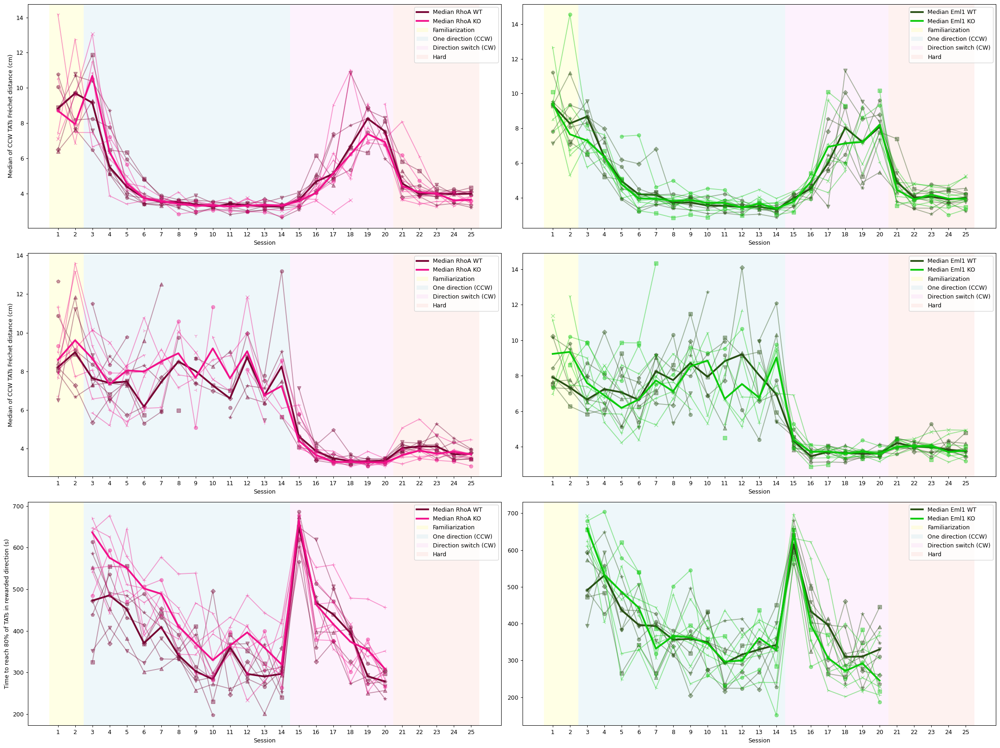

In [ ]:
fig, axs = plt.subplots(3, 2, figsize=(24, 18), dpi=90)

plot_metrics_method_paper(axs[0,0], overall_ccw_turns_frechet_distances_per_session, RhoA_groups, RhoA_colors, ylabel="Median of CCW TATs Fréchet distance (cm)")
plot_metrics_method_paper(axs[0,1], overall_ccw_turns_frechet_distances_per_session, Eml1_groups, Eml1_colors, ylabel=None)
plot_metrics_method_paper(axs[1,0], overall_cw_turns_frechet_distances_per_session, RhoA_groups, RhoA_colors, ylabel="Median of CW TATs Fréchet distance (cm)")
plot_metrics_method_paper(axs[1,1], overall_cw_turns_frechet_distances_per_session, Eml1_groups, Eml1_colors, ylabel=None)
plot_metrics_method_paper(axs[2,0], mice_tats_rewarded_dir_threshold_persession, RhoA_groups, RhoA_colors, ylabel="Time to reach 80% of TATs in rewarded direction (s)")
plot_metrics_method_paper(axs[2,1], mice_tats_rewarded_dir_threshold_persession, Eml1_groups, Eml1_colors, ylabel=None)

plt.tight_layout()
plt.show()